## EE 782: Advanced Topics in Machine Learning
### **Assignment 2:** Metric Learning & Generative AI
> **NAME:** Munish Monga

> **ROLL NO:** 22M2153

> [Github Repo Link](https://github.com/munish30monga/Metric_Learning-Generative_AI)

### Table of Contents:
- [Introduction](#introduction)
- [Importing Libraries](#importing-libraries)
- [Hyperparameters](#hyperparameters)
- [Exploring Dataset](#exploring-dataset)
- [Train-Test Split](#train-test-split)
- [Generating Pairs](#generating-pairs)
- [Visualizing Pairs](#visualizing-pairs)
- [Dataloader](#dataloader)
- [Data Preprocessing](#data-preprocessing)
- [Siamase Network](#siamase-network)
- [Loss Functions](#loss-functions)
- [Optimisers](#optimisers)
- [LR Schedulers](#lr-schedulers)
- [Data Augmentation](#data-augmentation)
- [Training Loop](#Training-loop)
- [Training Siamese Network (with ResNet-18 base)](#training-siamese-network(resnet-18))
- [Plotting Training and Validation Loss](#plotting-training-and-validation-loss)
- [Evaluating Model](#evaluating-model)
- [Display Predictions](#display-predictions)
- [Siamese Main Function](#siamese-main-function)
- [Ablation](#ablation-study)
    - [Changing Base Models](#changing-base-models)
    - [Changing Loss Functions](#changing-loss-functions)
    - [Changing Number of Augmentations](#applying-data-augmentation)
    - [Changing Number of Layers to Freeze](#changing-number-of-layers-to-freeze)
    - [Changing Regularization Techniques](#changing-regularization-techniques)
    - [Changing LR Schedulers](#changing-lr-schedulers)
    - [Changing Optimizers](#changing-optimizers)
- [Testing on Real Images](#testing-on-real-images)
- [References:  ](#references)

### Introduction <a id="introduction"></a>
**PART A: Metric Learning using Siamese Network**
> We have to train a Siamese Network on Labeled Faces in the Wild (LFW) Dataset


**PART B: Generative AI using GANs**
> We have to train a generative model for generating face images, using a GAN.

### Importing Libraries <a id="importing-libraries"></a>

In [1]:
import pathlib as pl                                                # for path handling
import matplotlib.pyplot as plt                                     # for plotting
from PIL import Image                                               # for image handling
from sklearn.model_selection import train_test_split                # for splitting data
import random                                                       # for random number generation
import torch                                                        # for deep learning functionality
import numpy as np                                                  # for numerical operations  
import matplotlib.pyplot as plt                                     # for plotting 
import torch.nn as nn                                               # for neural network functionality
import torch.nn.functional as F                                     # for neural network functionality        
import torch                                                        # for deep learning functionality
import torchvision.transforms as T                                  # for image transformations
from torch.utils.data import Dataset, DataLoader                    # for dataset handling
from tqdm import tqdm                                               # for progress bar
import timm                                                         # for pretrained models
import albumentations as A                                          # for image augmentations
from albumentations.pytorch import ToTensorV2                       # for image augmentations
from itertools import combinations                                  # for combinations
from prettytable import PrettyTable                                 # for table formatting
import copy                                                         # for copying objects 
from sklearn.metrics import classification_report                   # for model evaluation
from torchsummary import summary                                    # for model summary
import shutil                                                       # for file handling
import os                                                           # for file handling

### Hyperparameters <a id="hyperparameters"></a>

In [2]:
batch_size = 64                                                             # batch size for training
random_seed = 42                                                            # for reproducibility
random.seed(random_seed)                                                    # set random seed
os.environ['CUDA_VISIBLE_DEVICES'] = '2'                                    # set visible cuda device
device = 'cuda' if torch.cuda.is_available() else 'cpu'                     # set device to cuda if available
epochs = 20                                                                 # number of epochs to train
learning_rate = 0.01                                                        # learning rate for optimizer
base_model = "resnet18"                                                     # base model for Siamese network
loss_function = "BCE" # "hinge_loss", "BCE"                                 # loss function for Siamese network
margin = 1                                                                  # margin for hinge loss
threshold = 0.5                                                             # threshold for euclidean distance
max_positive_combinations=5                                                 # maximum number of positive combinations
patience = 0                                                                # patience for early stopping (0 means no early stopping)
lr_scheduler = None #'CosineAnnealingLR','ReduceLROnPlateau','CyclicLR'     # learning rate scheduler (None means no scheduler)
optimizer_type = 'Adam' # 'Adagrad', 'RMSprop'                              # optimizer type
weight_decay = 0                                                            # weight decay for optimizer (0 means no weight decay)
apply_augmentation = False                                                  # apply augmentation to training data or not
num_augmentations = 0                                                       # number of augmentations to apply per person
unfreeze_last_n = 0                                                         # unfreeze last n layers of base model (0 means no unfreezing, -1 means make all layers trainable)

## **PART A:** Metric Learning using Siamese Network <a id="part-a"></a>
### Downloading Dataset
> <font color="gray">Q1. Download labeled faces in the wild (LFW) dataset</font>

LFW Dataset was downloaded and extracted into the following path: `./dataset/lfw/`

### Exploring Dataset <a id="exploring-dataset"></a>

In [3]:
data_dir = pl.Path('./dataset/lfw/')                         # Setting path to the data directory
persons_dirs = [d for d in data_dir.iterdir() if d.is_dir()] # List all subdirectories (each directory corresponds to a person)
all_persons_dict = {person_dir.name: len(list(person_dir.glob("*.jpg"))) for person_dir in persons_dirs} # Create a dictionary of all persons and the number of images they have
all_persons = list(all_persons_dict.keys())                  # List of all persons

In [4]:
print(f"Total number of persons: {len(all_persons)}")                # Print the number of persons
for i, (person, num_images) in enumerate(all_persons_dict.items()):  # Loop through all persons dictionary
    if i >= 10:                                                      # Break the loop after printing 10 persons
        break
    print(f"{i+1}.{person}: {num_images}")                           # Print the number of images for each person

Total number of persons: 5749
1.Maria_Guida: 1
2.Lon_Kruger: 2
3.Dennis_Miller: 1
4.Nathalia_Gillot: 1
5.Camryn_Manheim: 1
6.Justin_Timberlake: 8
7.Vanessa_Laine: 1
8.Ion_Tiriac: 1
9.Stephen_Swindal: 1
10.Sandra_Shamas: 1


> <font color="gray">Q2. Get the number of persons who have more than one image</font>

In [5]:
persons_with_mul_imgs_dict = {person: num_images for person, num_images in all_persons_dict.items() if num_images > 1} # Create a dictionary of persons with more than one image
print(f"Number of persons with more than one image: {len(persons_with_mul_imgs_dict)}")                                # Print the number of persons with more than one image
for i, (person, num_images) in enumerate(persons_with_mul_imgs_dict.items()):                                          # Loop through all persons with more than one image
    if i >= 10:                                                                                                        # Break the loop after printing 10 persons
        break
    print(f"{i+1}.{person}: {num_images}")                                                                             # Print the number of images for each person                                               

Number of persons with more than one image: 1680
1.Lon_Kruger: 2
2.Justin_Timberlake: 8
3.George_Ryan: 4
4.Robert_DeFraites: 2
5.Ray_Romano: 9
6.Kim_Dae-jung: 8
7.Spencer_Abraham: 17
8.Cristina_Fernandez: 2
9.Bud_Selig: 4
10.Luke_Walton: 2


### Visualizing Dataset <a id="visualizing-dataset"></a>

In [3]:
def visualize_dataset(persons_dict):
    """
    Visualizes a grid of persons' images.
    
    Args:
    - persons_dict (dict): Dictionary with person names as keys and the number of images as values.
    """
    fig, axes = plt.subplots(8, 8, figsize=(15, 15))              # Create a figure with 8x8 subplots
    grid_position = 0                                             # Counter for the position in the 8x8 grid
    for person, count in persons_dict.items():                    # Loop through all persons in the dictionary  
        if grid_position >= 64:                                   # Break after 64 cells
            break
        person_dir = data_dir / person                            # Path to the person's directory  
        images = list(person_dir.glob("*.jpg"))                   # List all images in the person's directory  
        for img_path in images:
            if grid_position >= 64:                               # Break after 64 cells
                break
            image = Image.open(img_path)                          # Open the image using PIL's `Image.open()
            image = image.resize((64, 64))                        # Resize the image to 64x64
            row, col = divmod(grid_position, 8)                   # Get the row and column number  
            axes[row, col].imshow(image)                          # Plot the image on the subplot
            axes[row, col].axis('off')                            # Turn off the axis                         
            axes[row, col].set_title(f"{person}")                 # Set the title of the subplot to the person's name
            grid_position += 1                                    # Increment the grid position

    plt.tight_layout()
    plt.show()

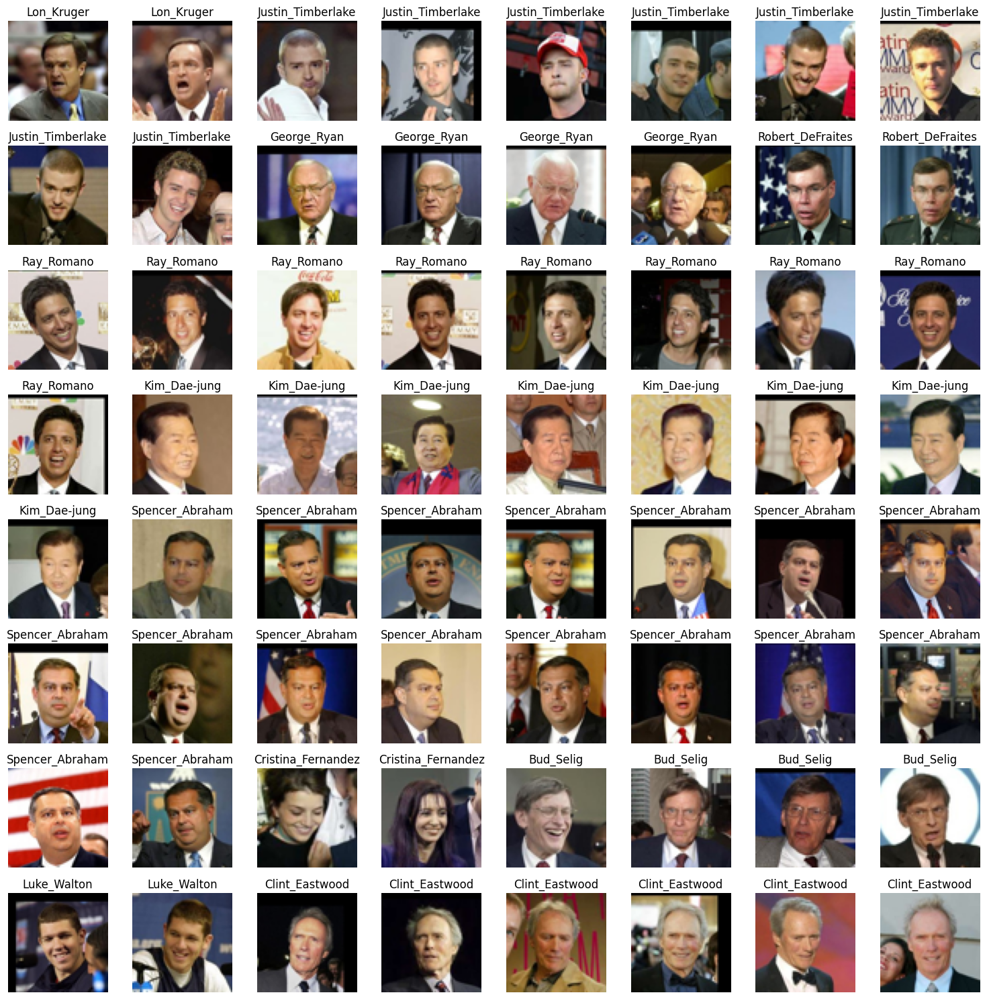

In [7]:
visualize_dataset(persons_with_mul_imgs_dict)

### Train-Test Split <a id="train-test-split"></a>
> <font color="gray">Q3. Split into training, validation, and testing by person (not by image)</font>

The `split_data` function is designed to split `all_persons_dict`. The function first identifies persons with only one image (referred to as `single_image_persons`) and those with more than one image (referred to as `multi_image_persons`). Persons with multiple images are crucial for training a Siamese network since we require pairs of images to compute the similarity or dissimilarity score. Therefore, the majority of these persons (80%) are allocated to the training set. The remaining 20% is reserved for validation and test sets. The remaining 20% of multi-image persons are equally split into validation and test sets, ensuring that both sets get a fair distribution of persons. 

Persons with only one image pose a challenge because they don't have a pair within their set to compare with. Also their count is significant and therefore, we cannot ignore them. To address this, all `single_image_persons` are added to the training set. The rationale behind this decision is that during training, data augmentation techniques can be applied to generate synthetic variants of these single images, thereby creating `pseudo-positive-pairs` of these persons for training the Siamese network.


In [4]:
def split_data(persons_dict):
    """
    Split persons data for training a Siamese network.
    
    Args:
    - persons_dict (dict): Dictionary with person names as keys and the number of images as values.

    Returns:
    - train_persons_dict (dict): Dictionary for training set.
    - valid_persons_dict (dict): Dictionary for validation set.
    - test_persons_dict (dict): Dictionary for test set.
    """
    single_image_persons = [person for person, count in persons_dict.items() if count == 1]     # List of persons with only one image
    multi_image_persons = [person for person, count in persons_dict.items() if count > 1]       # List of persons with more than one image
    train_multi_persons, remaining_persons = train_test_split(multi_image_persons, test_size=0.2, random_state=42) # Split the multi-image persons into 80% for training and 20% for validation + test
    valid_persons, test_persons = train_test_split(remaining_persons, test_size=0.5, random_state=42)   # Split the remaining 20% equally into validation and test sets
    train_persons = single_image_persons + train_multi_persons # Add single image persons to training set
    
    # Create dictionaries for each set
    train_persons_dict = {person: persons_dict[person] for person in train_persons}
    valid_persons_dict = {person: persons_dict[person] for person in valid_persons}
    test_persons_dict = {person: persons_dict[person] for person in test_persons}
    
    return train_persons_dict, valid_persons_dict, test_persons_dict

In [8]:
train_persons_dict, valid_persons_dict, test_persons_dict = split_data(all_persons_dict)    # Split the data into training, validation and test sets
print(f"Number of persons in Training Set: {len(train_persons_dict)}")
print(f"Number of persons in Validation Set {len(valid_persons_dict)}")
print(f"Number of persons in Test Set {len(test_persons_dict)}")

Number of persons in Training Set: 5413
Number of persons in Validation Set 168
Number of persons in Test Set 168


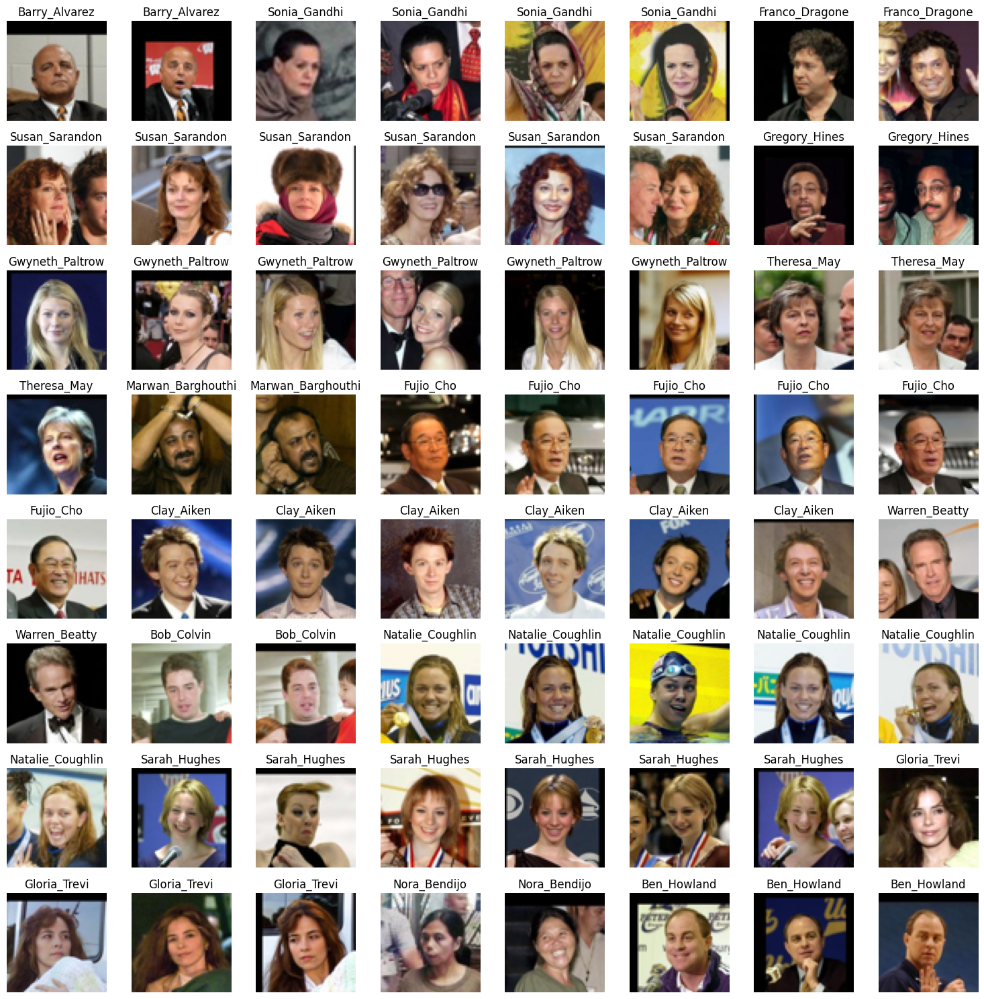

In [10]:
visualize_dataset(test_persons_dict)

### Generating Pairs <a id="generating-pairs"></a>

**`Positive Pairs Generation`:**

- **From Original Images**: For persons with at least two original images, all possible combinations of image pairs are generated provided this number doesn't exceed `max_positive_combinations`. For example, if a person has 4 images then maximum number of combinations that can be generated are $\binom{4}{2} = 6$. However, if `max_positive_combinations` is set to 4, then only 4 combinations will be selected.
- **From Augmented Images**: For persons with only one original image and if augmentation is enabled (`apply_augmentation=True`), positive pairs are created by pairing the original image with each of its augmented variants.

**`Negative Pairs Generation`:**

For every positive pair generated (whether from original or augmented images), a negative pair is also created. **This ensures that the number of positive and negative pairs remains equal**, providing a balanced dataset for training the Siamese network. The negative pair consists of one image from the current positive pair and another image from a different person.

**`Controlling Pair Generation`:**

- **Using `max_positive_combinations`**: This variable controls the maximum number of positive pairs generated from the original images of a person. It ensures that if a person has a large number of images, the function doesn't generate an overwhelmingly large number of positive pairs.
- **Using `apply_augmentation`**: This boolean variable determines whether augmented images should be used to generate additional positive pairs for persons with only one original image. .

Code snippet for the following cell is referred from [[4],[5]](#references)

In [5]:
def generate_pairs(persons_dict, max_positive_combinations, apply_augmentation, num_augmentations):
    """
    Generates pairs of images (both positive and negative) for Siamese training.
    
    Args:
    - persons_dict (dict): Dictionary with person names as keys and the number of images as values.
    - max_positive_combinations (int): Maximum number of positive combinations per person.
    Returns:
    - X (list): List of image pairs.
    - Y (list): List of labels indicating whether the pair is positive or negative.
    - positive_pairs_count (int): Number of positive pairs.
    - negative_pairs_count (int): Number of negative pairs.
    """
    X, Y = [], []                                               # Initialize lists for image pairs and labels
    person_names = list(persons_dict.keys())                    # List of person names
    
    data_dir = pl.Path('./dataset/lfw/')                        # Setting path to the data directory
    augmented_data_dir = pl.Path('./augmented_dataset/')        # Setting path to the augmented data directory
    
    positive_pairs_count, negative_pairs_count = 0, 0           # Initialize counters for positive and negative pairs
            
    for idx, person in enumerate(person_names):                 # Loop through all persons
        person_dir = data_dir / person                          # Path to the person's directory
        images = list(person_dir.glob("*.jpg"))                 # List all images in the person's directory
            
        # Positive pairs generation from original images
        if len(images) >= 2:                                    # Only generate pairs if the person has more than one image
            all_combinations = list(combinations(images, 2))    # Generate all possible combinations of images
            selected_combinations = random.sample(all_combinations, min(max_positive_combinations, len(all_combinations)))  # Select a random subset of combinations constrained by max_positive_combinations
            
            for img1, img2 in selected_combinations:        # Loop through all selected combinations
                X.append([img1, img2])                      # Append the pair to the list of pairs
                Y.append(1.0)                               # Same person
                positive_pairs_count += 1                   # Increment the counter for positive pairs

                # Generate a negative pair for every positive pair  
                other_persons = [p for p in person_names if p != person]    # List of all other persons
                if other_persons:                                           # Only generate negative pairs if there are other persons
                    other_person = random.choice(other_persons)             # Select a random other person
                    other_person_dir = data_dir / other_person              # Path to the other person's directory
                    other_person_images = list(other_person_dir.glob("*.jpg"))  # List all images in the other person's directory
                    
                    if other_person_images:                                 # Only generate negative pairs if the other person has images
                        img1_neg = random.choice(images)                    # Select a random image from the original person
                        img2_neg = random.choice(other_person_images)       # Select a random image from the other person
                        X.append([img1_neg, img2_neg])                      # Append the pair to the list of pairs
                        Y.append(0.0)                                       # Different persons
                        negative_pairs_count += 1                           # Increment the counter for negative pairs
                        
        # Positive pairs generation from augmented images
        if len(images) == 1 and apply_augmentation:                         # Only generate pairs if the person has only one image and augmentation is applied
            person_augmented_dir = augmented_data_dir / person              # Path to the person's augmented directory
            augmented_images = list(person_augmented_dir.glob("*.jpg"))     # List all images in the person's augmented directory
            
            for img1 in images:                                             # This will loop only once since len(images) == 1
                for img2 in augmented_images:                               # Loop through all augmented images
                    X.append([img1, img2])                                  # Pairing original image with each augmented image
                    Y.append(1.0)                                           # Same person using augmented images
                    positive_pairs_count += 1                               # Increment the counter for positive pairs

                    # Generate a negative pair for every positive pair
                    other_persons = [p for p in person_names if p != person]    # List of all other persons
                    if other_persons:                                           # Only generate negative pairs if there are other persons
                        other_person = random.choice(other_persons)             # Select a random other person    
                        other_person_dir = data_dir / other_person              # Path to the other person's directory
                        other_person_images = list(other_person_dir.glob("*.jpg"))  # List all images in the other person's directory

                        if other_person_images:                                 # Only generate negative pairs if the other person has images
                            img1_neg = img1                                     # Select the original image from the original person
                            img2_neg = random.choice(other_person_images)       # Select a random image from the other person
                            X.append([img1_neg, img2_neg])                      # Append the pair to the list of pairs
                            Y.append(0.0)                                       # Different persons
                            negative_pairs_count += 1                           # Increment the counter for negative pairs

    return X, Y, positive_pairs_count, negative_pairs_count

**X (List of Image Pairs)**:
`X` is a list where each entry represents a pair of images to be fed into the Siamese network. Each entry in this list is itself a list containing two elements: the paths to the two images that form the pair. For instance, if the pair consists of images `img1.jpg` and `img2.jpg`, the corresponding entry in `X` would be `[path_to_img1, path_to_img2]`.

**Y (List of Labels)**:
`Y` is a list containing labels corresponding to each pair in `X`. The label indicates whether the pair is positive (both images are of the same person) or negative (images are of different persons). Specifically:
- A label of `1.0` indicates a positive pair (images are of the same person).
- A label of `0.0` indicates a negative pair (images are of different persons).

In [30]:
X_train_pairs, Y_train_pairs, positive_pairs_count_train, negative_pairs_count_train = generate_pairs(train_persons_dict, max_positive_combinations=10, apply_augmentation=False, num_augmentations=0)
X_valid_pairs, Y_valid_pairs, positive_pairs_count_valid, negative_pairs_count_valid = generate_pairs(valid_persons_dict, max_positive_combinations=1, apply_augmentation=False, num_augmentations=0)
X_test_pairs, Y_test_pairs, positive_pairs_count_test, negative_pairs_count_test = generate_pairs(test_persons_dict, max_positive_combinations=1, apply_augmentation=False, num_augmentations=0)
table = PrettyTable()
table.field_names = ["Dataset Split", "Number of Persons", "Number of Positive Pairs", "Number of Negative Pairs"]
table.add_row(["Training Set", len(train_persons_dict), positive_pairs_count_train, negative_pairs_count_train])
table.add_row(["Validation Set", len(valid_persons_dict), positive_pairs_count_valid, negative_pairs_count_valid])
table.add_row(["Test Set", len(test_persons_dict), positive_pairs_count_test, negative_pairs_count_test])
print(table)

+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |           5735           |           5735           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+


Here, we are not apply data augmentation to any set. Notice that `max_positive_combinations` is set to 10 for training set only, but is set to 1 for validation and test sets. This is because we don't want to generate too many positive pairs for validation and test sets, since they are not used for training the model. 

### Visualizing Pairs <a id="visualizing-pairs"></a>
Code snippet for the following cell is referred from [[4]](#references)

In [6]:
def visualize_pairs(X, Y):
    """
    Visualizes pairs of images from X along with their label from Y.

    Args:
    - X (list): List of image pairs.
    - Y (list): List of labels.
    """
    fig, axes = plt.subplots(4, 4, figsize=(15, 5*4))           # Create a figure with 4x4 subplots
    
    pos_idx = [i for i, label in enumerate(Y) if label == 1.0]  # Indices of positive pairs
    neg_idx = [i for i, label in enumerate(Y) if label == 0.0]  # Indices of negative pairs

    # Shuffle the indices
    random.shuffle(pos_idx)                                     # Shuffle the indices of positive pairs                              
    random.shuffle(neg_idx)                                     # Shuffle the indices of negative pairs

    for row in range(4):
        # Display positive pairs
        img_path1, img_path2 = X[pos_idx[row]]                  # Get the paths of the images in the pair
        image1 = Image.open(img_path1)                          # Open the image using PIL's `Image.open()
        image2 = Image.open(img_path2)
        person1_name = img_path1.parent.name  # Assuming the parent directory is the person's name
        person2_name = img_path2.parent.name
        
        axes[row, 0].imshow(np.array(image1), cmap='gray')      # Plot the image on the subplot
        axes[row, 0].axis('off')
        axes[row, 0].set_title(person1_name, fontsize = 18)

        axes[row, 1].imshow(np.array(image2), cmap='gray')
        axes[row, 1].axis('off')
        axes[row, 1].set_title(person2_name, fontsize = 18)

        # Display negative pairs    
        img_path1, img_path2 = X[neg_idx[row]]            # Get the paths of the images in the pair
        image1 = Image.open(img_path1)
        image2 = Image.open(img_path2)
        person1_name = img_path1.parent.name  # Assuming the parent directory is the person's name
        person2_name = img_path2.parent.name

        axes[row, 2].imshow(np.array(image1), cmap='gray')    # Plot the image on the subplot
        axes[row, 2].axis('off')
        axes[row, 2].set_title(person1_name, fontsize = 18)

        axes[row, 3].imshow(np.array(image2), cmap='gray')
        axes[row, 3].axis('off')
        axes[row, 3].set_title(person2_name, fontsize = 18)

    
    fig.text(0.25, 1, 'Positive Pairs', ha='center', va='center', fontsize=24)  # Setting main titles for Positive and Negative pairs 
    fig.text(0.75, 1, 'Negative Pairs', ha='center', va='center', fontsize=24)
    
    plt.tight_layout()
    plt.show()

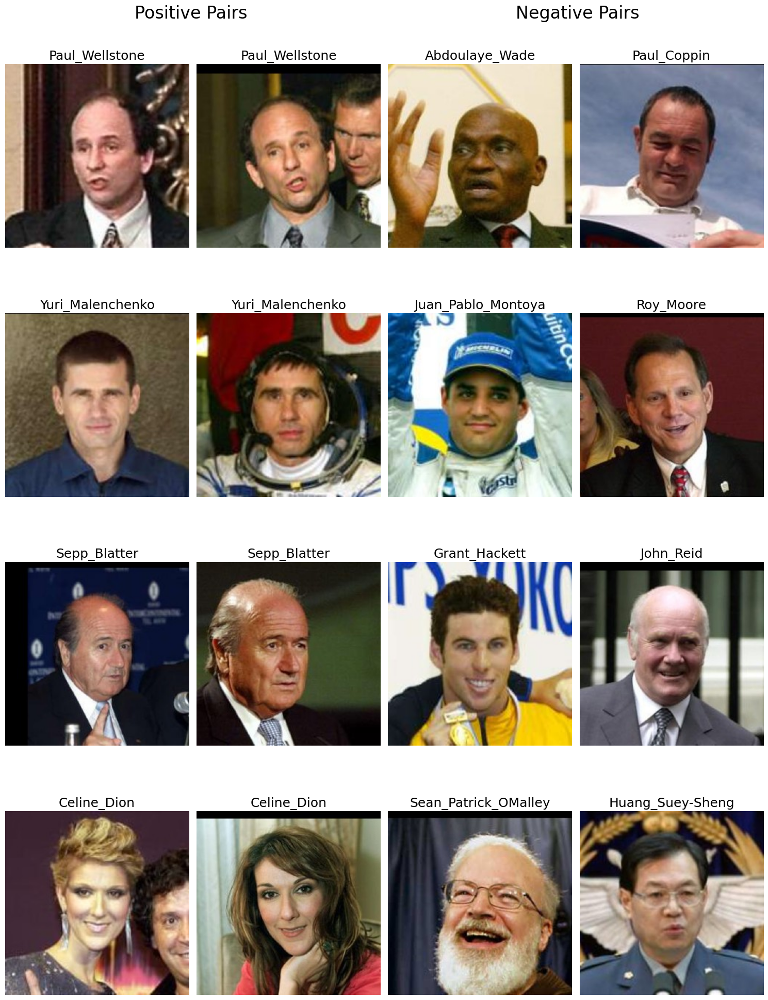

In [14]:
visualize_pairs(X_train_pairs, Y_train_pairs)

### Data Augmentation <a id="data-augmentation"></a>
> <font color="gray">Q6a. Use image augmentation</font>

In the function `generate_positive_pairs`, a series of image augmentations have been applied to artificially increase the dataset size and add variability. 

1. **Color Jitter**: Randomly changes the brightness and contrast of the image.
2. **Horizontal Flip**: Randomly flips the image horizontally.
3. **Random Brightness and Contrast**: Adjusts the brightness and contrast of the image with specified limits.
4. **Gaussian Blur**: Applies a Gaussian blur to the image with a random kernel size.
5. **Coarse Dropout**: Randomly drops out chunks of the input image, replacing them with black patches.

The primary goal of the `generate_positive_pairs` function is to produce augmented versions of images of persons that have only one image in the dataset. These augmented images are treated as positive pairs with the original image, enabling the Siamese network to learn from them as if they were distinct images of the same person.

**`num_augmentations`**: This parameter determines how many augmented versions of an image will be created. For instance, if set to 5, five different augmented images will be produced for each person with a single image in the dataset. For each person with a single image, the function generates `num_augmentations` new images, treating them as positive pairs with the original image. Code snippet for the following cell is referred from [[4]](#references)

In [ ]:
def generate_positive_pairs(persons_dict, num_augmentations=5):
    transforms = A.Compose([
        A.ColorJitter(brightness=0.5, contrast=0.5),                                 # Randomly change brightness and contrast
        A.HorizontalFlip(),                                                          # Randomly flip the image horizontally
        A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.5),    # Randomly change brightness and contrast
        A.GaussianBlur(blur_limit=(3, 7), p=0.5),                                        # Randomly blur the image
        A.CoarseDropout(max_holes=8, max_height=25, max_width=25, fill_value=0, p=0.5), # Randomly drop out patches from the image
        ToTensorV2()
    ])
    data_dir = pl.Path('./dataset/lfw/')
    augmented_dataset_dir = pl.Path('./augmented_dataset/')
    
    # Remove the existing directory and its contents
    if augmented_dataset_dir.exists():
        shutil.rmtree(augmented_dataset_dir)
    
    # Recreate the directory
    augmented_dataset_dir.mkdir(parents=True, exist_ok=True)
    
    person_names = list(persons_dict.keys())
    augmented_persons_count = 0
    total_augmented_images = 0
    
    for idx, person in enumerate(person_names):                 # Loop through all persons
        person_dir = data_dir / person
        images = list(person_dir.glob("*.jpg"))
        
        if len(images) == 1:
            augmented_persons_count += 1                        # Increment the counter for augmented persons
            person_augmented_dir = augmented_dataset_dir / person       # Path to the person's augmented directory
            person_augmented_dir.mkdir(parents=True, exist_ok=True)
            
            for i in range(num_augmentations):                      # Loop through the number of augmentations
                augmented_image_tensor = transforms(image=np.array(Image.open(images[0])))["image"] # Apply transformations to the image
                # Convert tensor back to PIL Image
                augmented_image = T.ToPILImage()(augmented_image_tensor)    # Convert the tensor to PIL Image
                image_path = person_augmented_dir / f"augmented_{i}.jpg"    
                augmented_image.save(image_path)
                total_augmented_images += 1                             # Increment the counter for augmented images

    print(f"Total number of augmented images generated = Augmented Persons x Augmentations per person = {augmented_persons_count} x {num_augmentations} = {total_augmented_images}")

In [ ]:
generate_positive_pairs(train_persons_dict, num_augmentations=1)

Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 1 = 4069


In [ ]:
X_train_pairs_aug, Y_train_pairs_aug, positive_pairs_count_train, negative_pairs_count_train = generate_pairs(train_persons_dict, max_positive_combinations=6, apply_augmentation=True, num_augmentations=1)
X_valid_pairs_aug, Y_valid_pairs_aug, positive_pairs_count_valid, negative_pairs_count_valid = generate_pairs(valid_persons_dict, max_positive_combinations=6, apply_augmentation=False, num_augmentations=0)
X_test_pairs_aug, Y_test_pairs_aug, positive_pairs_count_test, negative_pairs_count_test = generate_pairs(test_persons_dict, max_positive_combinations=6, apply_augmentation=False, num_augmentations=0)
table = PrettyTable()
table.field_names = ["Dataset Split", "Number of Persons", "Number of Positive Pairs", "Number of Negative Pairs"]
table.add_row(["Training Set", len(train_persons_dict), positive_pairs_count_train, negative_pairs_count_train])
table.add_row(["Validation Set", len(valid_persons_dict), positive_pairs_count_valid, negative_pairs_count_valid])
table.add_row(["Test Set", len(test_persons_dict), positive_pairs_count_test, negative_pairs_count_test])
print("Dataset Table after augmentation:")
print(table)

Dataset Table after augmentation:
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |           8388           |           8388           |
| Validation Set |        168        |           477            |           477            |
|    Test Set    |        168        |           516            |           516            |
+----------------+-------------------+--------------------------+--------------------------+


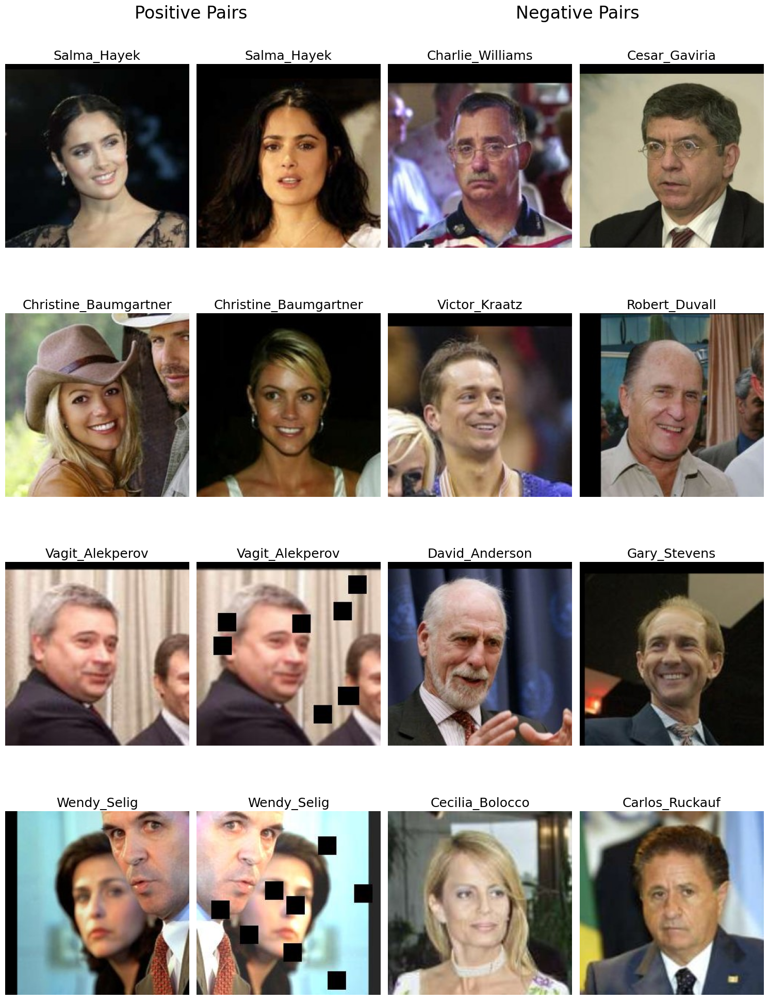

In [ ]:
visualize_pairs(X_train_pairs_aug, Y_train_pairs_aug)

### Data Preprocessing <a id="data-preprocessing"></a>
> <font color="gray">Q5. Appropriately crop and resize the images based on your computational resources</font>

Here, I have done a `CenterCrop` of size `128` then applied normalization using `mean=[0.485, 0.456, 0.406]` and `std=[0.229, 0.224, 0.225]`, using the ImageNet mean and standard deviation values.

In [7]:
def preprocess_data(X):
    """
    Preprocess the images in X using albumentations by applying a center crop and normalization.

    Args:
    - X (list): List of image pairs.

    Returns:
    - X_processed (list): List of preprocessed image pairs.
    """
    transform = A.Compose([
        A.CenterCrop(128, 128),                 
        A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ToTensorV2()
    ])
    
    X_processed = []

    for pair in X:
        processed_pair = [transform(image=np.array(Image.open(img_path)))["image"] for img_path in pair]
        X_processed.append(processed_pair)

    return X_processed

In [8]:
def denormalize(tensor, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    """
    Denormalize a tensor.

    Args:
    - tensor (torch.Tensor): The normalized tensor.
    - mean (list): The mean values used for normalization.
    - std (list): The standard deviation values used for normalization.

    Returns:
    - torch.Tensor: The denormalized tensor.
    """
    mean = torch.tensor(mean).view(1, 3, 1, 1)
    std = torch.tensor(std).view(1, 3, 1, 1)
    return tensor * std + mean

In [9]:
def dict_to_tensors(persons_dict, max_positive_combinations, apply_augmentation, num_augmentations):
    """
    Converts a dictionary of persons into tensors of image pairs and labels.

    Args:
    - persons_dict (dict): Dictionary with person names as keys and the number of images as values.

    Returns:
    - X_tensor (torch.Tensor): Tensor of image pairs.
    - Y_tensor (torch.Tensor): Tensor of labels.
    """
    X, Y, _, _ = generate_pairs(persons_dict, max_positive_combinations, apply_augmentation=apply_augmentation, num_augmentations=num_augmentations)    
    
    # Preprocess the data (apply center cropping and normalization)
    X = preprocess_data(X)

    # Assuming all images have the same dimensions after cropping and transformations
    first_image = X[0][0]
    _, img_height, img_width = first_image.size()

    # Convert the images to tensors
    X_tensor = torch.empty((len(X), 2, 3, img_height, img_width))  # Shape: (num_pairs, 2, 3, img_height, img_width)
    
    for i, (img1, img2) in enumerate(X):
        X_tensor[i, 0] = img1
        X_tensor[i, 1] = img2
    
    Y_tensor = torch.tensor(Y, dtype=torch.float32)

    return X_tensor, Y_tensor

In [31]:
X_train, Y_train = dict_to_tensors(train_persons_dict, max_positive_combinations=10, apply_augmentation=False, num_augmentations=0)
X_valid, Y_valid = dict_to_tensors(valid_persons_dict, max_positive_combinations=1, apply_augmentation=False, num_augmentations=0)
X_test, Y_test = dict_to_tensors(test_persons_dict, max_positive_combinations=1, apply_augmentation=False, num_augmentations=0)

In [32]:
# Create a table
table = PrettyTable()
# Define column headers
table.field_names = ["Dataset Split", "X Shape", "Y Shape"]
# Add rows
table.add_row(["Training Set", X_train.shape, Y_train.shape])
table.add_row(["Validation Set", X_valid.shape, Y_valid.shape])
table.add_row(["Test Set", X_test.shape, Y_test.shape])
print(table)

+----------------+-------------------------------------+---------------------+
| Dataset Split  |               X Shape               |       Y Shape       |
+----------------+-------------------------------------+---------------------+
|  Training Set  | torch.Size([11470, 2, 3, 128, 128]) | torch.Size([11470]) |
| Validation Set |  torch.Size([336, 2, 3, 128, 128])  |  torch.Size([336])  |
|    Test Set    |  torch.Size([336, 2, 3, 128, 128])  |  torch.Size([336])  |
+----------------+-------------------------------------+---------------------+


$\text{Shape of } X: (N, 2, C, H, W)$

$\text{Shape of } Y: (N)$

where:
- $N$: represents the Number of Training Samples = 2 $\times$ Number of Training Pairs.
- $2$: represennts a pair (two images)
- $C$: represents the Number of channels in the image (1 as we keep it grayscale)
- $H$: represents the Height of the image
- $W$: represents the Width of the image

### Dataloader <a id="dataloader"></a>

In [10]:
class SiameseDataset(Dataset):
    """
    Dataset class for Siamese networks.

    Attributes:
    - X (list): List of image pairs.
    - Y (list): List of labels indicating whether the pair is positive or negative.

    Methods:
    - __len__(): Returns the number of pairs in the dataset.
    - __getitem__(index): Returns the image pair and label at the given index.
    """
    def __init__(self, X, Y):
        """
        Initializes the SiameseDataset with given image pairs and labels.

        Args:
        - X (list): List of image pairs.
        - Y (list): List of labels.
        """
        self.X = X
        self.Y = Y

    def __len__(self):
        return len(self.Y)

    def __getitem__(self, index):
        img1 = self.X[index, 0]         # First image in the pair
        img2 = self.X[index, 1]         # Second image in the pair
        label = self.Y[index]
        return (img1, img2), label      # Return the image pair and label

In [34]:
train_dataset = SiameseDataset(X_train, Y_train)
valid_dataset = SiameseDataset(X_valid, Y_valid)
test_dataset = SiameseDataset(X_test, Y_test)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=16, pin_memory=True)
valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, num_workers=16, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=16, pin_memory=True)

In [21]:
# Fetching one batch from the DataLoader
for (img1_batch, img2_batch), labels_batch in train_loader:
    # We'll break after the first batch for demonstration
    print(f"Shape of img1_batch: {img1_batch.shape}")       # img1_train batch shape
    print(f"Shape of img2_batch: {img2_batch.shape}")       # img2_train batch shape
    print(f"Shape of labels_batch: {labels_batch.shape}")   # labels_train batch shape
    break

Shape of img1_batch: torch.Size([64, 3, 128, 128])
Shape of img2_batch: torch.Size([64, 3, 128, 128])
Shape of labels_batch: torch.Size([64])


In [29]:
def visualize_batch(dataloader, num_samples=4):
    # Fetch one batch of data
    (img1_batch, img2_batch), labels_batch = next(iter(dataloader))
    
    # Denormalize the images
    img1_batch = denormalize(img1_batch)
    img2_batch = denormalize(img2_batch)
    
    # Randomly sample indices for visualization
    indices = random.sample(range(len(labels_batch)), num_samples)
    
    fig, axes = plt.subplots(num_samples, 2, figsize=(6, 2 * num_samples))
    
    for i, idx in enumerate(indices):
        img1 = np.clip(img1_batch[idx].permute(1, 2, 0).numpy(), 0, 1)
        img2 = np.clip(img2_batch[idx].permute(1, 2, 0).numpy(), 0, 1)

        
        axes[i, 0].imshow(img1, cmap='gray')
        axes[i, 0].axis('off')
        
        axes[i, 1].imshow(img2, cmap='gray')
        axes[i, 1].axis('off')
        
        if labels_batch[idx] == 1.0:
            label = "Positive Pair"
        else:
            label = "Negative Pair"
        
        # Place the label to the left of the images in vertical fashion
        fig.text(0.1, (num_samples - i - 0.5) / num_samples, label, ha='center', va='center', fontsize=14, rotation=90)
    
    plt.tight_layout()
    plt.show()

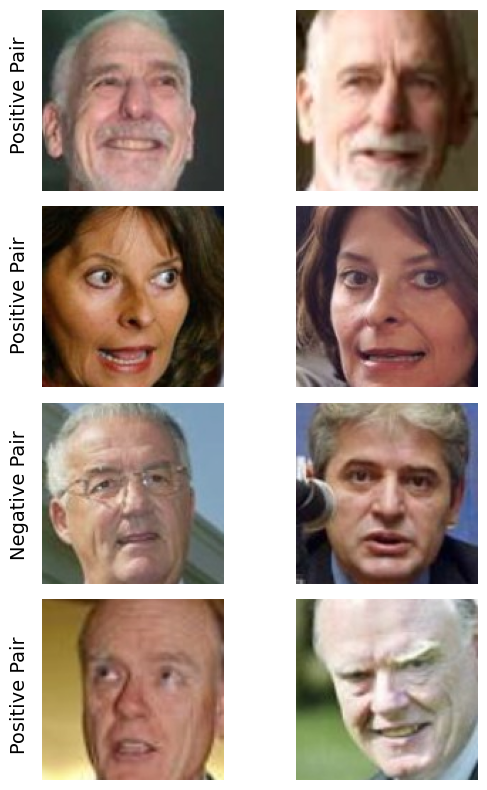

In [24]:
visualize_batch(train_loader)

### Siamase Network <a id="siamase-network"></a>
> <font color="gray">Q4. Start with a network that is pre-trained on ImageNet and appropriate for your computational
resources</font>

> <font color="gray">Q6. Setup and train a Siamese network to predict whether a pair of images are of the same person or not using a metric learning scheme</font>

The Siamese Network leverages a pre-trained base model for feature extraction. The base model can be **any** architecture available in the `timm` library, however I have tested the Siamese Network with four different architectures: `resnet18`, `efficientnetb0`, `inceptionv4`, and `resnet50`. 

Since the primary goal is to obtain feature embeddings and not classify images into predefined categories, the **classification head** (or the final fully connected layer) **of the base model is removed**. This results in the network producing high-dimensional feature maps as output. Post feature extraction, the high-dimensional feature map is passed through a projection layer, which consists of a linear layer followed by batch normalization. This projection layer transforms the embeddings to a** fixed size of 512**, inorder to perform downstream tasks of predicting whether a pair of images are of the same person or not.

The `unfreeze_last_n` parameter provides granular control over which layers of the base model are trainable. 

- `unfreeze_last_n = -1`: All layers of the base model are unfrozen, i.e. make all layers trainable.
- `unfreeze_last_n = 0`: All layers of the base model are frozen, use the pre-trained weights as is. (No fine-tuning). Note that the projection layer is still trainable.
- `unfreeze_last_n = n`: Only the last `n` layers of the base model are unfrozen, and hence trainable. The remaining layers are frozen, i.e. use the pre-trained weights as is. (Partial fine-tuning) 

**`forward_once` function**: This function computes the embedding for a single input image. The image is passed through the base model and then through the projection layer to produce a 512-dimensional embedding.

**`forward` function**: This function takes in two images as input and computes their embeddings using the `forward_once` function. The resultant embeddings can then be used to cosine similarity or euclidean distance between the two images. Code snippet for the following cell is referred from [[1],[2]](#references)

In [11]:
class SiameseNetwork(nn.Module):
    """
    Siamese Neural Network for learning embeddings using pairs of images. 

    Attributes:
    - base_model (nn.Module): The base model used for feature extraction.
    - embedding_size (int): Size of the embedding produced by the base model.
    - projection (nn.Linear): Linear layer to project embeddings to desired size (512).

    Methods:
    - forward_one(x): Computes the embedding for a single input image.
    - forward(input1, input2): Computes the embeddings for a pair of input images.
    """
    def __init__(self, base_model, unfreeze_last_n):
        """
        Initializes the SiameseNetwork with a given base model.

        Args:
        - base_model (str): Name of the base model to use
        - unfreeze_last_n (int): Number of layers to unfreeze from the end
        """
        super(SiameseNetwork, self).__init__()                  # Call the parent class's init function
        self.base_model = timm.create_model(base_model, pretrained=True)    # Load the pretrained base model
        self.embedding_size = self.base_model.num_features  # Get the number of features (embedding size) from the base model
        self.base_model = nn.Sequential(*list(self.base_model.children())[:-1]) # Remove the classification head

        # If unfreeze_last_n is -1, make all layers trainable
        if unfreeze_last_n == -1:
            for param in self.base_model.parameters():
                param.requires_grad = True
        else:
            # Freeze all layers initially
            for param in self.base_model.parameters():
                param.requires_grad = False

            # Unfreeze the last n layers
            num_layers = len(list(self.base_model.children()))
            for i, child in enumerate(self.base_model.children()):
                if i >= num_layers - unfreeze_last_n:
                    for param in child.parameters():
                        param.requires_grad = True
        
        # Projection layer to get embeddings of size 512
        self.projection = nn.Sequential(
            nn.Linear(self.embedding_size, 512),            # Linear layer
            nn.BatchNorm1d(512))                            # BatchNorm1d for better convergence

    def forward_once(self, x):
        # Forward pass for one input
        x = self.base_model(x)          # Get the embeddings from the base model
        x = x.view(x.size()[0], -1)     # Flatten the embeddings
        x = self.projection(x)          # Project the embeddings to the desired size
        return x

    def forward(self, input1, input2):
        # Forward pass for both inputs
        output1 = self.forward_once(input1)    # Forward pass for input1
        output2 = self.forward_once(input2)    # Forward pass for input2
        return output1, output2

In [ ]:
timm.list_models()

['bat_resnext26ts',
 'beit_base_patch16_224',
 'beit_base_patch16_384',
 'beit_large_patch16_224',
 'beit_large_patch16_384',
 'beit_large_patch16_512',
 'beitv2_base_patch16_224',
 'beitv2_large_patch16_224',
 'botnet26t_256',
 'botnet50ts_256',
 'caformer_b36',
 'caformer_m36',
 'caformer_s18',
 'caformer_s36',
 'cait_m36_384',
 'cait_m48_448',
 'cait_s24_224',
 'cait_s24_384',
 'cait_s36_384',
 'cait_xs24_384',
 'cait_xxs24_224',
 'cait_xxs24_384',
 'cait_xxs36_224',
 'cait_xxs36_384',
 'coat_lite_medium',
 'coat_lite_medium_384',
 'coat_lite_mini',
 'coat_lite_small',
 'coat_lite_tiny',
 'coat_mini',
 'coat_small',
 'coat_tiny',
 'coatnet_0_224',
 'coatnet_0_rw_224',
 'coatnet_1_224',
 'coatnet_1_rw_224',
 'coatnet_2_224',
 'coatnet_2_rw_224',
 'coatnet_3_224',
 'coatnet_3_rw_224',
 'coatnet_4_224',
 'coatnet_5_224',
 'coatnet_bn_0_rw_224',
 'coatnet_nano_cc_224',
 'coatnet_nano_rw_224',
 'coatnet_pico_rw_224',
 'coatnet_rmlp_0_rw_224',
 'coatnet_rmlp_1_rw2_224',
 'coatnet_rmlp_1_r

In [26]:
model = SiameseNetwork(base_model=base_model, unfreeze_last_n=0).to(device)
summary(model, [(3, 224, 224), (3, 224, 224)])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]          36,864
       BatchNorm2d-6           [-1, 64, 56, 56]             128
          Identity-7           [-1, 64, 56, 56]               0
              ReLU-8           [-1, 64, 56, 56]               0
          Identity-9           [-1, 64, 56, 56]               0
           Conv2d-10           [-1, 64, 56, 56]          36,864
      BatchNorm2d-11           [-1, 64, 56, 56]             128
             ReLU-12           [-1, 64, 56, 56]               0
       BasicBlock-13           [-1, 64, 56, 56]               0
           Conv2d-14           [-1, 64,

### Loss Functions <a id="loss-functions"></a>

I have used three different loss functions for training the Siamese Network:

1. **Binary Cross-Entropy (BCE) Loss**:
Given predictions $ p $ and true labels $ y $, the BCE loss is:

$$
L(y, p) = -\frac{1}{N} \sum_{i=1}^{N} y_i \log(p_i) + (1 - y_i) \log(1 - p_i)
$$

2. **Hinge Loss (Margin Ranking Loss)**:
Given two input values $ x_1 $ and $ x_2 $ and a target $ y $ (either 1 or -1), the hinge loss is:

$$
L(x_1, x_2, y) = \max(0, \text{margin} - y \times (x_1 - x_2))
$$

3. **Contrastive Loss**:
Given two embeddings $ o_1 $ and $ o_2 $ and a label $ l $ (1 if similar, 0 if dissimilar), the contrastive loss is:

$$
L(o_1, o_2, l) = (1-l) \times \text{dist}(o_1, o_2)^2 + l \times \max(0, \text{margin} - \text{dist}(o_1, o_2))^2
$$

where $\text{dist}(o_1, o_2)$ is the Euclidean distance between $ o_1 $ and $ o_2 $.

Contrastive loss focuses on pulling similar pairs closer and pushing dissimilar pairs apart. These dual objectives make contrastive loss particularly effective for Siamese networks, as it ensures that the embeddings are discriminative, making similar items cluster together and dissimilar items spread apart in the embedding space.
Also, the `loss_function` and `margin` are treated as hyperparameters. For the hinge and contrastive losses, the margin determines how far apart the embeddings of dissimilar pairs should be in the embedding space. It acts as a threshold and is crucial in ensuring that the embeddings are discriminative. Code snippet for the following cell is referred from [[6]](#references)

In [12]:
class ContrastiveLoss(nn.Module):
    """
    Contrastive loss for Siamese networks.

    Attributes:
    - margin (float): Margin for the contrastive loss.

    Methods:
    - forward(output1, output2, label): Computes the contrastive loss given a pair of embeddings and their label.
    """
    def __init__(self, margin=2.0):
        """
        Initializes the ContrastiveLoss with a given margin.

        Args:
        - margin (float): Margin for the contrastive loss.
        """
        super(ContrastiveLoss, self).__init__()
        self.margin = margin

    def forward(self, output1, output2, label):
        euclidean_distance = F.pairwise_distance(output1, output2)
        loss = torch.mean((1-label) * torch.pow(euclidean_distance, 2) +
                          (label) * torch.pow(torch.clamp(self.margin - euclidean_distance, min=0.0), 2))
        return loss

In [13]:
def choose_loss_function(loss_function, margin):
    """
    Chooses the loss function based on the given name.

    Args:
    - loss_function (str): Name of the loss function. Options are "BCE", "hinge_loss", and "contrastive".

    Returns:
    - loss_function (nn.Module): The loss function.
    """
    if loss_function == "BCE":
        criterion = torch.nn.BCEWithLogitsLoss()
        print("Using Cross Entropy Loss...")
    elif loss_function == "hinge_loss":
        criterion = torch.nn.MarginRankingLoss(margin=margin)
        print(f"Using Hinge Loss with margin={margin}...")
    elif loss_function == "contrastive":
        criterion = ContrastiveLoss(margin=margin)
        print(f"Using Contrastive Loss with margin={margin}...")
    else:
        raise ValueError("Invalid loss_function!")
    return criterion

### Optimisers <a id="optimisers"></a>

I have used three different optimizers for training the Siamese Network:
`Adam`, `Adagrad`, and `RMSProp`.

In [14]:
def choose_optimizer(model, optimizer_type, learning_rate, weight_decay):
    if optimizer_type == "Adam":
            optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)
            print(f"Using Adam optimizer with lr={learning_rate}, weight_decay={weight_decay}...")
    elif optimizer_type == "Adagrad":
        optimizer = torch.optim.Adagrad(model.parameters(), lr=learning_rate, weight_decay=weight_decay)
        print(f"Using Adagrad optimizer with lr={learning_rate}, weight_decay={weight_decay}...")
    elif optimizer_type == "RMSprop":
        optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate, weight_decay=weight_decay)
        print(f"Using RMSprop optimizer with lr={learning_rate}, weight_decay={weight_decay}...")
    else:
        raise ValueError("Invalid optimizer_type!")
    return optimizer

### LR Schedulers <a id="lr-schedulers"></a>

Three different learning rate schedulers were used for training the Siamese Network:
`CosineAnnealingLR`, `ReduceLROnPlateau`, and `CyclicLR`.

In [15]:
def choose_lr_scheduler(lr_scheduler, optimizer, num_epochs):
    if lr_scheduler == "CosineAnnealingLR":
        scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs, eta_min=0)
        print("Using CosineAnnealingLR scheduler...")
    elif lr_scheduler == "CyclicLR":
        base_lr = 1e-5
        max_lr = 1e-2
        scheduler = torch.optim.lr_scheduler.CyclicLR(optimizer, base_lr=base_lr, max_lr=max_lr, step_size_up=2000, mode='triangular2', cycle_momentum=False)
        print("Using CyclicLR scheduler...")
    elif lr_scheduler == "ReduceLROnPlateau":
        scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=3, verbose=True)
        print("Using ReduceLROnPlateau scheduler...")
    else:
        scheduler = None
    return scheduler

### Training Loop <a id="Training-loop"></a>
Code snippet for the following cell is referred from [[2],[4]](#references)

In [17]:
def train_model(model, train_loader, valid_loader, num_epochs, learning_rate, loss_function, margin, threshold, patience=0, lr_scheduler=None, weight_decay=0, optimizer_type="Adam"):
    """
    Training Loop for Siamese network model.

    Args:
    - model (nn.Module): The Siamese network model to train.
    - train_loader (DataLoader): DataLoader for training data.
    - valid_loader (DataLoader): DataLoader for validation data.
    - num_epochs (int): Number of epochs to train for.
    - learning_rate (float): Learning rate for the optimizer.
    - loss_function (str): The type of loss function to be used - 'contrastive' or 'BCE'.

    Returns:
    - model (nn.Module): The trained model.
    - train_losses (list): List of training losses per epoch.
    - valid_losses (list): List of validation losses per epoch.
    """
    model = model.to(device)
    
    # Decide Loss function
    criterion = choose_loss_function(loss_function, margin)
    
    # Decide optimizer
    optimizer = choose_optimizer(model, optimizer_type, learning_rate, weight_decay)
    
    # Define learning rate scheduler
    scheduler = choose_lr_scheduler(lr_scheduler, optimizer, num_epochs)

    train_losses, valid_losses = [], []
    train_accuracies, valid_accuracies = [], []
    best_valid_loss = float('inf')
    epochs_without_improvement = 0
    
    for epoch in range(1, num_epochs+1):
        model.train()
        running_train_loss = 0.0
        correct_train_predictions = 0  # Track correct training predictions
        total_train_samples = 0
        pbar = tqdm(train_loader, total=len(train_loader), leave=False)
        
        for _, (pairs, labels) in enumerate(pbar):
            
            input1, input2 = pairs[0].to(device), pairs[1].to(device)   # Move input tensors to the device
            labels = labels.to(device).float()                  # Move labels to the device
            
            optimizer.zero_grad()                           # Clear gradients
            output1, output2 = model(input1, input2)        # Forward pass
            
            # Using cosine similarity
            if loss_function == "contrastive":                  
                distance = F.pairwise_distance(output1, output2)    # Compute distance between embeddings
                preds = (distance < threshold).float()  # Use threshold for predictions based on distance
            else:
                similarity = F.cosine_similarity(output1, output2)  # Compute similarity between embeddings
                preds = (similarity > threshold).float()  # Use threshold for predictions based on similarity

            correct_train_predictions += (preds == labels).sum().item()  # Compute correct predictions
            total_train_samples += labels.size(0)            # Increment the total number of samples
            
            if loss_function == "BCE":
                loss = criterion(similarity, labels)
            elif loss_function == "hinge_loss":
                hinge_labels = 2*labels - 1
                loss = criterion(similarity, hinge_labels, torch.ones_like(labels))
            elif loss_function == "contrastive":
                loss = criterion(output1, output2, 1-labels)

            running_train_loss += loss.item()
            loss.backward()
            optimizer.step()
            
            pbar.set_postfix(train_loss=loss.item())
        
        avg_train_loss = running_train_loss / len(train_loader)         # Compute average training loss
        train_accuracy = correct_train_predictions / total_train_samples
        train_losses.append(avg_train_loss)
        train_accuracies.append(train_accuracy)
        
        # Validation
        model.eval()
        running_valid_loss = 0.0
        correct_valid_predictions = 0  # Track correct validation predictions
        total_valid_samples = 0
        
        for _, (pairs, labels) in enumerate(valid_loader):                  # Loop through the validation set
            input1, input2 = pairs[0].to(device), pairs[1].to(device)
            labels = labels.to(device).float()
            
            with torch.no_grad():                           # Turn off gradients
                output1, output2 = model(input1, input2)    # Forward pass
                
                if loss_function == "contrastive":
                    distance = F.pairwise_distance(output1, output2)    # Compute distance between embeddings for contrastive loss
                    preds = (distance < threshold).float()  # Use threshold for predictions based on distance
                else:
                    similarity = F.cosine_similarity(output1, output2)  # Compute cosine similarity between embeddings for BCE and Hinge Loss
                    preds = (similarity > threshold).float()  # Use threshold for predictions based on similarity

                correct_valid_predictions += (preds == labels).sum().item()  # Compute correct predictions
                total_valid_samples += labels.size(0)
                
                if loss_function == "BCE":
                    loss = criterion(similarity, labels)
                elif loss_function == "hinge_loss":
                    hinge_labels = 2*labels - 1
                    loss = criterion(similarity, hinge_labels, torch.ones_like(labels))
                elif loss_function == "contrastive":
                    loss = criterion(output1, output2, 1-labels)

                running_valid_loss += loss.item()
        
        avg_valid_loss = running_valid_loss / len(valid_loader)
        valid_accuracy = correct_valid_predictions / total_valid_samples 
        valid_losses.append(avg_valid_loss)
        valid_accuracies.append(valid_accuracy)
        
        # Learning Rate Scheduling
        if scheduler:
            if isinstance(scheduler, torch.optim.lr_scheduler.ReduceLROnPlateau):
                scheduler.step(avg_valid_loss)
            else:
                scheduler.step()

        # Early Stopping
        if patience > 0:
            if avg_valid_loss < best_valid_loss:
                best_valid_loss = avg_valid_loss
                epochs_without_improvement = 0
                # Save best model weights
                best_model_weights = copy.deepcopy(model.state_dict())
            else:
                epochs_without_improvement += 1
                if epochs_without_improvement == patience:
                    print(f"Early stopping!!, Since validation loss has not improved in the last {patience} epochs.")
                    # Load best model weights
                    model.load_state_dict(best_model_weights)
                    break

        # Print epoch details
        print(f'''{"#"*100}
Epoch: [{epoch}/{num_epochs}] | Epoch Train Loss: {avg_train_loss} | Epoch Valid Loss: {avg_valid_loss}
{"#"*100}''')
            
    return model, train_losses, valid_losses, train_accuracies, valid_accuracies

When I pass loss_function as `contrastive`, the training loop uses `euclidean distance` to compute the distance between the embeddings. When I pass loss_function as `BCE` or `hinge`, the training loop uses `cosine similarity` to compute the distance between the embeddings.

### Training Siamese Network (with ResNet-18 base) <a id="training-siamese-network(resnet-18)"></a>

In [83]:
model_resnet18 = SiameseNetwork(base_model=base_model, unfreeze_last_n=unfreeze_last_n)    
trained_model, train_losses, valid_losses, train_accuracies, valid_accuracies = train_model(model_resnet18, train_loader, valid_loader, epochs, learning_rate, loss_function, margin, threshold, patience, lr_scheduler, weight_decay, optimizer_type)

Using Cross Entropy Loss...
Using Adam optimizer with lr=0.01, weight_decay=0...


####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 0.6321641554435095 | Epoch Valid Loss: 0.634505162636439
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.6027763389878803 | Epoch Valid Loss: 0.6257239878177643
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.5928981300857332 | Epoch Valid Loss: 0.6245444019635519
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.5881224380599128 | Epoch Valid Loss: 0.6287782986958822
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.5844931993219588 | Epoch Valid Loss: 0.621688594420751
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.5807022449043062 | Epoch Valid Loss: 0.6343185206254324
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.5794132540623347 | Epoch Valid Loss: 0.6234415074189504
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.5789799339241452 | Epoch Valid Loss: 0.6291507184505463
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.5782014558712641 | Epoch Valid Loss: 0.6256267925103506
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.576307796438535 | Epoch Valid Loss: 0.6282775004704794
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.5755249871148004 | Epoch Valid Loss: 0.6226896047592163
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.5756584094630347 | Epoch Valid Loss: 0.6255297859509786
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.5734983033604092 | Epoch Valid Loss: 0.6296061972777048
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.5743469850884544 | Epoch Valid Loss: 0.6222532490889231
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.5719040417008929 | Epoch Valid Loss: 0.6313082873821259
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.5718112428983052 | Epoch Valid Loss: 0.6252436737219492
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.5728383858998617 | Epoch Valid Loss: 0.6322996218999227
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.5740723576810625 | Epoch Valid Loss: 0.6253278652826945
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.5720585862795512 | Epoch Valid Loss: 0.6321967244148254
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.5715261492464278 | Epoch Valid Loss: 0.625671903292338
####################################################################################################


### Plotting Training and Validation Loss <a id="plotting-training-and-validation-loss"></a>
Code snippet for the following cell is referred from [[4]](#references)

In [18]:
def plot_losses(train_losses, valid_losses, train_accuracies, valid_accuracies):
    """
    Plots training and validation losses and accuracies per epoch.
    
    Args:
    - train_losses (list): Training losses per epoch.
    - valid_losses (list): Validation losses per epoch.
    - train_accuracies (list): Training accuracies per epoch.
    - valid_accuracies (list): Validation accuracies per epoch.
    """
    epochs = range(1, len(train_losses) + 1)  # Create a list of epochs
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))  # Create a figure and two axes

    # Plotting train and valid losses on the left subplot
    ax1.plot(epochs, train_losses, label='Training Loss', marker='o', color='blue')
    ax1.plot(epochs, valid_losses, label='Validation Loss', marker='o', color='red')
    ax1.set_title('Training & Validation Losses')
    ax1.set_xlabel('Epochs')
    ax1.set_ylabel('Loss')
    ax1.legend()
    ax1.grid(True)

    # Plotting train and valid accuracies on the right subplot
    ax2.plot(epochs, train_accuracies, label='Training Accuracy', marker='o', color='blue')
    ax2.plot(epochs, valid_accuracies, label='Validation Accuracy', marker='o', color='red')
    ax2.set_title('Training & Validation Accuracies')
    ax2.set_xlabel('Epochs')
    ax2.set_ylabel('Accuracy')
    ax2.legend()
    ax2.grid(True)

    plt.tight_layout()
    plt.show()

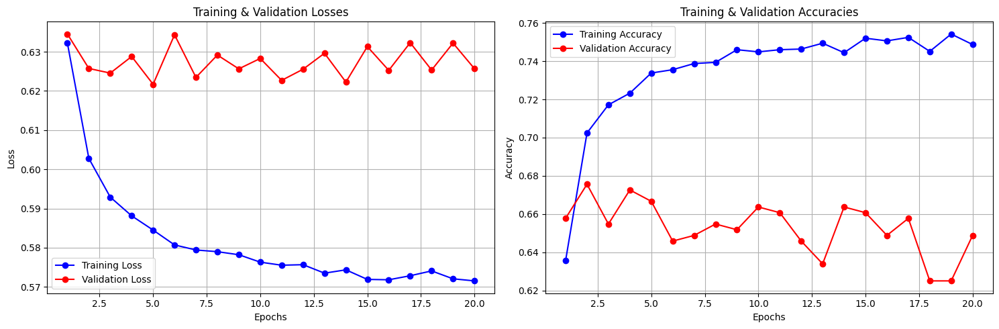

In [90]:
plot_losses(train_losses, valid_losses, train_accuracies, valid_accuracies)

### Evaluating Model <a id="evaluating-model"></a> 
<font color="gray">Q9. Test on the test split</font>

Code snippet for the following cell is referred from [[1],[4]](#references)

In [19]:
def evaluate_model(model, dataloader, threshold, loss_function):
    """
    Evaluate the Siamese network model on given dataloader.

    Args:
    - model (nn.Module): The trained Siamese network model.
    - dataloader (DataLoader): DataLoader for evaluation data.
    - threshold (float): Threshold for cosine similarity to make binary predictions.

    Returns:
    - avg_accuracy (float): Average accuracy on the dataloader.
    - class_report (str): Classification report with precision, recall, etc.
    """
    model = model.to(device)
    model.eval()
    
    total_samples = 0
    correct_predictions = 0
    all_preds = []
    all_labels = []
    
    for _, (pairs, labels) in enumerate(dataloader):
        input1, input2 = pairs[0].to(device), pairs[1].to(device)
        labels = labels.to(device).float()
        
        with torch.no_grad():
            output1, output2 = model(input1, input2)
            if loss_function == "contrastive":
                distance = F.pairwise_distance(output1, output2) # Use euclidean distance for contrastive loss 
                preds = (distance < threshold).float()  # Use threshold for predictions based on distance
            else:
                similarity = F.cosine_similarity(output1, output2) # Use cosine similarity for BCE and Hinge Loss
                preds = (similarity > threshold).float()  # Use threshold for predictions based on similarity

            correct_predictions += (preds == labels).sum().item()
            total_samples += labels.size(0)
            
            # Store predictions and labels for classification report
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    avg_accuracy = correct_predictions / total_samples
    class_report = classification_report(all_labels, all_preds, target_names=["Negative Pair", "Positive Pair"])
    
    return avg_accuracy, class_report

In [91]:
test_accuracy, class_report = evaluate_model(trained_model, test_loader, threshold=threshold, loss_function=loss_function)

In [92]:
accuracy_table = PrettyTable()
accuracy_table.title = f"Model Performance with '{base_model}' base"
accuracy_table.field_names = ["Split", "Accuracy (%)"]
accuracy_table.add_row(["Training", f"{np.mean(train_accuracies)*100:.2f}"])
accuracy_table.add_row(["Validation", f"{np.mean(valid_accuracies)*100:.2f}"])
accuracy_table.add_row(["Test", f"{test_accuracy*100:.2f}"])
print(accuracy_table)
print(f"Classification Report:\n{class_report}")

+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        73.53         |
|    Validation   |        65.31         |
|       Test      |        66.96         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.61      0.92      0.74       168
Positive Pair       0.84      0.42      0.56       168

     accuracy                           0.67       336
    macro avg       0.73      0.67      0.65       336
 weighted avg       0.73      0.67      0.65       336



As shown above in the classification report, the support for positive and negative pair is perfectly balanced, despite that we have somewhat lower `precision` on `negative pair` and lower `recall` on `positive pair`. This was a general trend that I observed across all the models that I trained.

### Display Predictions <a id="display-predictions"></a>
Code snippet for the following cell is referred from [[4]](#references)

In [20]:
def display_predictions(model, dataloader, threshold, title, loss_function):
    model.eval()
    model = model.to(device)
    count = 0

    # Creating a main figure for our 8 pairs of images
    fig, axes = plt.subplots(4, 2, figsize=(20, 20))
    
    for (pairs, actual_labels) in dataloader:
        if count >= 8:
            break

        input1, input2 = pairs[0].to(device), pairs[1].to(device)
        output1, output2 = model(input1, input2)
        
        if loss_function == "contrastive":
            distance = F.pairwise_distance(output1, output2).cpu().detach().numpy() # Use euclidean distance for contrastive loss
            predicted_labels = (distance < threshold).astype(float)
        else:
            similarity = F.cosine_similarity(output1, output2).cpu().detach().numpy()   # Use cosine similarity for BCE and Hinge Loss
            predicted_labels = (similarity > threshold).astype(float)

        for idx in range(len(predicted_labels)):
            # Setting the title with predicted and actual labels
            pair_title = f"Predicted: {'Same Person' if predicted_labels[idx] == 1.0 else 'Different Person'} | Actual: {'Same Person' if actual_labels[idx] == 1.0 else 'Different Person'}"
            
            # Denormalizing the images and ensure we're working with single images, not batches
            img1 = denormalize(pairs[0][idx].unsqueeze(0)).squeeze(0).permute(1, 2, 0).numpy().clip(0, 1)
            img2 = denormalize(pairs[1][idx].unsqueeze(0)).squeeze(0).permute(1, 2, 0).numpy().clip(0, 1)

            # Display the two images concatenated side by side
            axes[count//2, count%2].imshow(np.concatenate((img1, img2), axis=1))
            
            # Setting the title with color based on match
            title_color = 'red' if predicted_labels[idx] != actual_labels[idx] else 'black'
            axes[count//2, count%2].set_title(pair_title, size=18, x=0.47, color=title_color)

            # Removing axes
            axes[count//2, count%2].axis('off')

            count += 1
            if count >= 8:
                break
    
    # Setting the main title for the entire figure
    fig.suptitle(title, size=24, weight='bold', y=1)
    plt.tight_layout()
    plt.show()

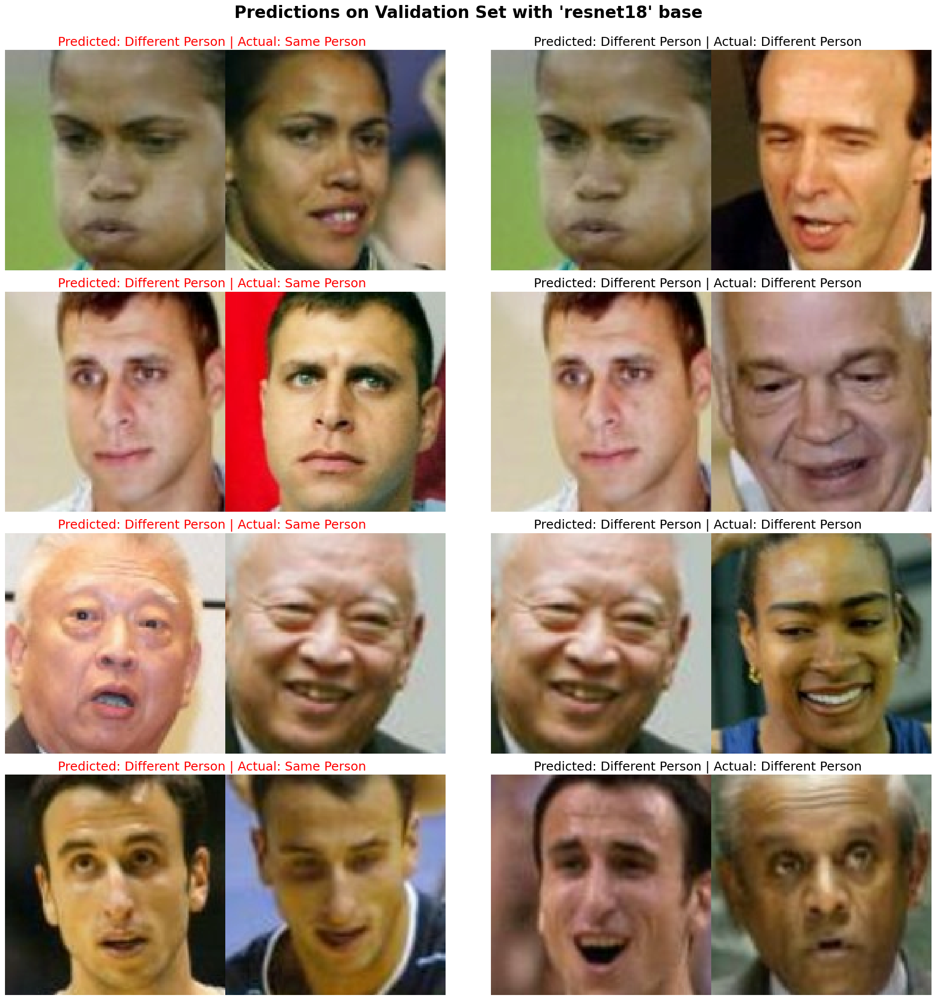

In [109]:
display_predictions(trained_model, valid_loader, threshold=threshold, title=f"Predictions on Validation Set with '{base_model}' base", loss_function=loss_function)

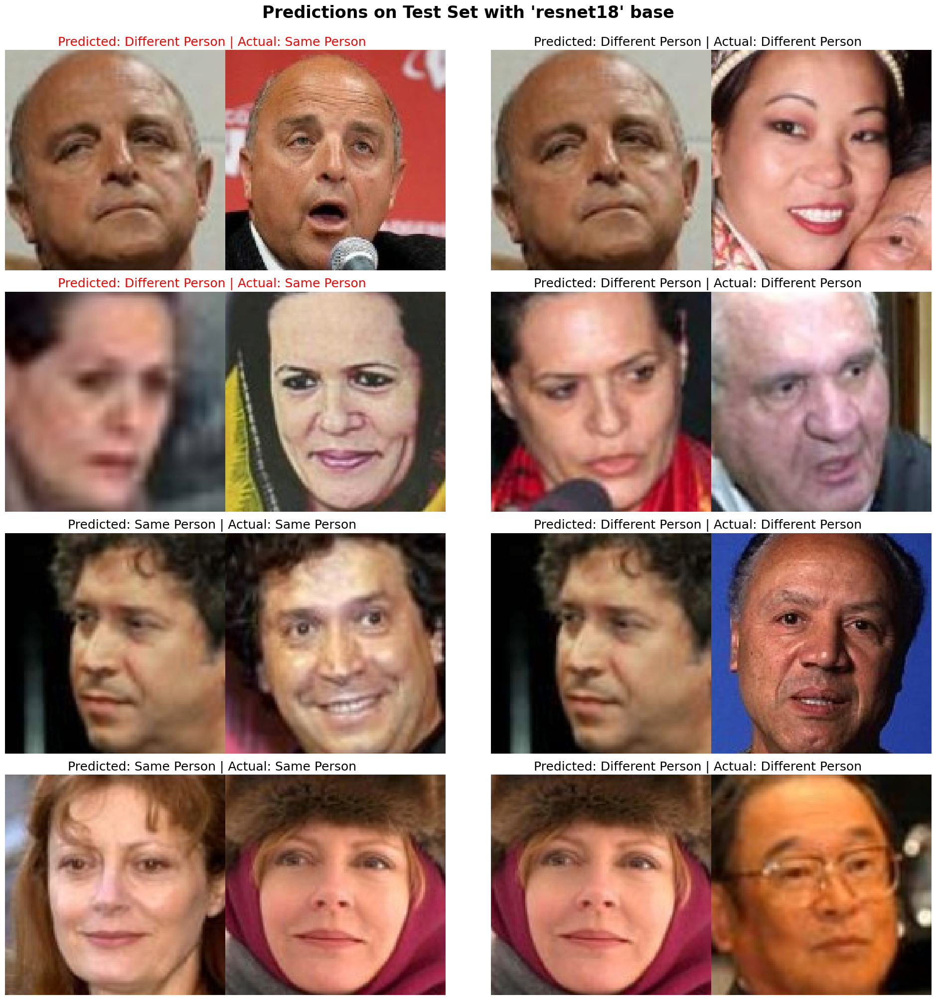

In [110]:
display_predictions(trained_model, test_loader, threshold=threshold, title=f"Predictions on Test Set with '{base_model}' base", loss_function=loss_function)

### Siamese Main Function <a id="siamese-main-function"></a>

In [21]:
def Siamese_main(hyperparameters, plot_loss, disp_preds, print_tables, visualize):
    """
    Main function for training, evaluating, and optionally visualizing the Siamese Network's performance.

    Args:
    - hyperparameters (dict): Dictionary containing hyperparameters for training and model setup.
    - plot_losses (bool): Whether to plot training and validation losses.
    - display_predictions (bool): Whether to display some model predictions.

    Returns:
    - trained_model (SiameseNetwork): Trained Siamese Network model.
    - accuracy (float): Model accuracy on the test set.
    - report (str): Classification report for the model on the test set.
    """
    data_dir = pl.Path('./dataset/lfw/')     # Setting path to the data directory
    persons_dirs = [d for d in data_dir.iterdir() if d.is_dir()] # List all subdirectories (each directory corresponds to a person)
    all_persons_dict = {person_dir.name: len(list(person_dir.glob("*.jpg"))) for person_dir in persons_dirs} # Create a dictionary of all persons and the number of images they have
    all_persons = list(all_persons_dict.keys())             # List of all persons 
    persons_with_mul_imgs_dict = {person: num_images for person, num_images in all_persons_dict.items() if num_images > 1} 

    train_persons_dict, valid_persons_dict, test_persons_dict = split_data(all_persons_dict)
    
    if hyperparameters['apply_augmentation']:
        print("Generating augmented images...")
        generate_positive_pairs(train_persons_dict, num_augmentations=hyperparameters['num_augmentations'])
        
    X_train_pairs, Y_train_pairs, positive_pairs_count_train, negative_pairs_count_train = generate_pairs(train_persons_dict, max_positive_combinations=hyperparameters['max_positive_combinations'], apply_augmentation=hyperparameters['apply_augmentation'], num_augmentations=hyperparameters['num_augmentations'])
    X_valid_pairs, Y_valid_pairs, positive_pairs_count_valid, negative_pairs_count_valid = generate_pairs(valid_persons_dict, max_positive_combinations=1, apply_augmentation=False, num_augmentations=0)
    X_test_pairs, Y_test_pairs, positive_pairs_count_test, negative_pairs_count_test = generate_pairs(test_persons_dict, max_positive_combinations=1, apply_augmentation=False, num_augmentations=0)

    print("Generating tensors...")
    X_train, Y_train = dict_to_tensors(train_persons_dict, max_positive_combinations=hyperparameters['max_positive_combinations'], apply_augmentation=hyperparameters['apply_augmentation'], num_augmentations=hyperparameters['num_augmentations'])
    X_valid, Y_valid = dict_to_tensors(valid_persons_dict, max_positive_combinations=1, apply_augmentation=False, num_augmentations=0)
    X_test, Y_test = dict_to_tensors(test_persons_dict, max_positive_combinations=1, apply_augmentation=False, num_augmentations=0)
    
    train_dataset = SiameseDataset(X_train, Y_train)
    valid_dataset = SiameseDataset(X_valid, Y_valid)
    test_dataset = SiameseDataset(X_test, Y_test)
    train_loader = DataLoader(train_dataset, batch_size=hyperparameters['batch_size'], shuffle=True, num_workers=16, pin_memory=True)
    valid_loader = DataLoader(valid_dataset, batch_size=hyperparameters['batch_size'], shuffle=False, num_workers=16, pin_memory=True)
    test_loader = DataLoader(test_dataset, batch_size=hyperparameters['batch_size'], shuffle=False, num_workers=16, pin_memory=True)

    if print_tables:
        print(f"Toal number of persons: {len(all_persons)}")
        print(f"Number of persons with more than one image: {len(persons_with_mul_imgs_dict)}")
        table = PrettyTable()
        table.field_names = ["Dataset Split", "Number of Persons", "Number of Positive Pairs", "Number of Negative Pairs"]
        table.add_row(["Training Set", len(train_persons_dict), positive_pairs_count_train, negative_pairs_count_train])
        table.add_row(["Validation Set", len(valid_persons_dict), positive_pairs_count_valid, negative_pairs_count_valid])
        table.add_row(["Test Set", len(test_persons_dict), positive_pairs_count_test, negative_pairs_count_test])
        print(table)
    
    if visualize:
        visualize_pairs(X_train_pairs, Y_train_pairs)  
    
    print(f"Training Siamese Network with Hyperparameters:\n{hyperparameters}")
    # Initialize model
    model = SiameseNetwork(base_model=hyperparameters['base_model'], unfreeze_last_n=hyperparameters['unfreeze_last_n'])
    
    # Train model
    trained_model, train_losses, valid_losses, train_accuracies, valid_accuracies = train_model(
        model, 
        train_loader, 
        valid_loader, 
        hyperparameters['epochs'], 
        hyperparameters['learning_rate'],
        hyperparameters['loss_function'],
        hyperparameters['margin'],
        hyperparameters['threshold'],
        patience=hyperparameters['patience'],
        lr_scheduler=hyperparameters['lr_scheduler'],
        weight_decay=hyperparameters['weight_decay'],
        optimizer_type=hyperparameters['optimizer_type']
    )
    
    # Evaluate model
    avg_train_accuracy, avg_valid_accuracy = np.mean(train_accuracies)*100, np.mean(valid_accuracies)*100
    avg_test_accuracy, class_report = evaluate_model(trained_model, test_loader, threshold=hyperparameters['threshold'], loss_function = hyperparameters['loss_function'])
    accuracy_table = PrettyTable()
    accuracy_table.title = f"Model Performance with '{hyperparameters['base_model']}' base"
    accuracy_table.field_names = ["Split", "Accuracy (%)"]
    accuracy_table.add_row(["Training", f"{avg_train_accuracy:.2f}"])
    accuracy_table.add_row(["Validation", f"{avg_valid_accuracy:.2f}"])
    accuracy_table.add_row(["Test", f"{avg_test_accuracy*100:.2f}"])
    print(accuracy_table)
    print(f"Classification Report:\n{class_report}")
    
    # Optionally plot losses
    if plot_loss:
        plot_losses(train_losses, valid_losses, train_accuracies, valid_accuracies)
    
    # Optionally display predictions
    if disp_preds:
        display_predictions(trained_model, valid_loader, threshold=hyperparameters['threshold'], title=f"Predictions on Validation Set with '{hyperparameters['base_model']}' base", loss_function = hyperparameters['loss_function'])
        display_predictions(trained_model, test_loader, threshold=hyperparameters['threshold'], title=f"Predictions on Test Set with '{hyperparameters['base_model']}' base", loss_function=hyperparameters['loss_function'])
    
    return trained_model, avg_train_accuracy, avg_valid_accuracy, avg_test_accuracy, class_report

## Ablation <a id="ablation-study"></a>

In [22]:
hyperparameters = {
'batch_size': 64,
'random_seed': 42,
'epochs': 20,
'learning_rate': 0.01,
'base_model': 'resnet18',
'margin': 1.0,
'threshold': 0.5,
'max_positive_combinations': 10,
'loss_function': 'contrastive', # 'BCE', 'hinge_loss', 'contrastive'
'patience': 5,
'lr_scheduler': None, # 'CosineAnnealingLR', 'CyclicLR', 'ReduceLROnPlateau'
'optimizer_type': 'Adam', # 'Adam', 'Adagrad', 'RMSprop'
'weight_decay': 0,
'apply_augmentation': True,
'num_augmentations': 4,
'unfreeze_last_n': 4
}

### Changing Base Models <a id="changing-base-models"></a>

Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |           5735           |           5735           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_rate': 0.01, 'base_model': 'resnet18', 'margin': 1.0, 'threshold': 0.5, 'max_positive_combinations': 10, 'loss_function': 'contrastive', 'patience': 0, 'lr_schedu

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 79.48828650448057 | Epoch Valid Loss: 2.6194888750712075
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.5270924314856529 | Epoch Valid Loss: 0.2188715860247612
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.20673259976837371 | Epoch Valid Loss: 0.20408843457698822
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.20064985247121916 | Epoch Valid Loss: 0.20369633038838705
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.19877799534135396 | Epoch Valid Loss: 0.20000435411930084
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.1969519862698184 | Epoch Valid Loss: 0.2003142014145851
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.19285508063104417 | Epoch Valid Loss: 0.19928085803985596
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.19068412623471684 | Epoch Valid Loss: 0.1986564670999845
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.1872437487045924 | Epoch Valid Loss: 0.1949686755736669
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.18624188461237484 | Epoch Valid Loss: 0.19190356383721033
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.18381769748197663 | Epoch Valid Loss: 0.19140912840763727
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.18202252255545723 | Epoch Valid Loss: 0.19363205134868622
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.1808851010269589 | Epoch Valid Loss: 0.1947095443805059
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.178711499273777 | Epoch Valid Loss: 0.1998810643951098
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.17590233609080314 | Epoch Valid Loss: 0.19965534408887228
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.1751623860663838 | Epoch Valid Loss: 0.19753818462292352
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.17475401692920262 | Epoch Valid Loss: 0.20119938751061758
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.17470348229010899 | Epoch Valid Loss: 0.199854185183843
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.17335712007350393 | Epoch Valid Loss: 0.19948802391688028
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.17414657639132605 | Epoch Valid Loss: 0.1984597792228063
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        71.57         |
|    Validation   |        67.08         |
|       Test      |        63.39         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.63      0.65      0.64       168
Positive Pair       0.64      0.61      0.63       168

     accuracy                           0.63       336
    macro avg       0.63      0.63      0.63       336
 weighted avg    

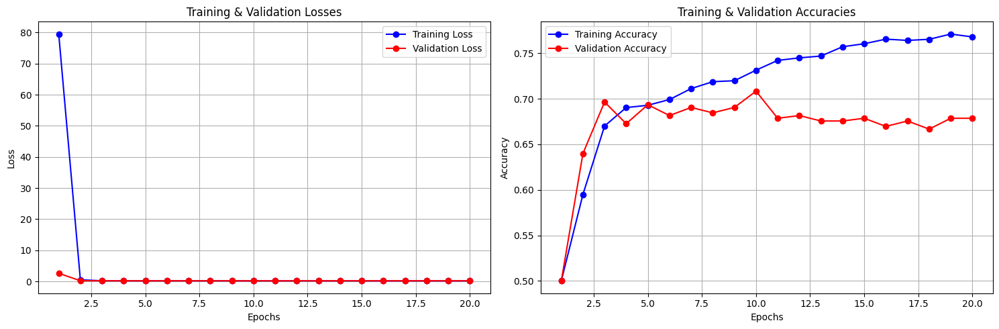

Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |           5735           |           5735           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_rate': 0.01, 'base_model': 'resnet50', 'margin': 1.0, 'threshold': 0.5, 'max_positive_combinations': 10, 'loss_function': 'contrastive', 'patience': 0, 'lr_schedu

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 91.12526791228188 | Epoch Valid Loss: 1.9586878220240276
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.39826665214366386 | Epoch Valid Loss: 0.22615972657998404
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.2236351384056939 | Epoch Valid Loss: 0.2243640497326851
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.22072799594865905 | Epoch Valid Loss: 0.2212673450509707
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.21767154178685613 | Epoch Valid Loss: 0.22091785073280334
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.21477501201960775 | Epoch Valid Loss: 0.22173425058523813
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.21232605998714765 | Epoch Valid Loss: 0.222054253021876
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.20714185924993622 | Epoch Valid Loss: 0.22209191073973975
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.20124439431561364 | Epoch Valid Loss: 0.21647712836662927
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.19302278906106948 | Epoch Valid Loss: 0.21328544119993845
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.18584743564327558 | Epoch Valid Loss: 0.22779927651087442
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.17976051113671726 | Epoch Valid Loss: 0.23237241804599762
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.1751657081147035 | Epoch Valid Loss: 0.2271518980463346
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.17140383968750636 | Epoch Valid Loss: 0.26984034727017087
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.1699299627708064 | Epoch Valid Loss: 0.21321763594945273
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.16652287286188866 | Epoch Valid Loss: 0.21877498924732208
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.1651122120519479 | Epoch Valid Loss: 0.2264950821797053
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.16255589690473343 | Epoch Valid Loss: 0.20362226168314615
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.1628996714949608 | Epoch Valid Loss: 0.2495363305012385
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.16074866445528135 | Epoch Valid Loss: 0.23955545077721277
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet50' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        70.90         |
|    Validation   |        64.18         |
|       Test      |        61.31         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.59      0.71      0.65       168
Positive Pair       0.64      0.51      0.57       168

     accuracy                           0.61       336
    macro avg       0.62      0.61      0.61       336
 weighted avg   

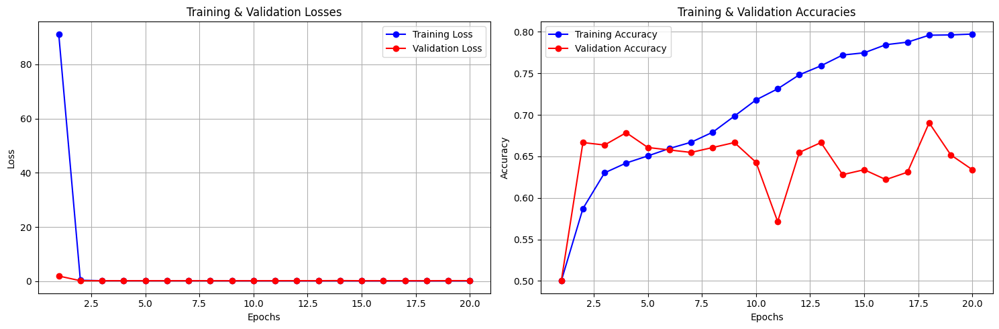

Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |           5735           |           5735           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_rate': 0.01, 'base_model': 'efficientnet_b0', 'margin': 1.0, 'threshold': 0.5, 'max_positive_combinations': 10, 'loss_function': 'contrastive', 'patience': 0, 'lr

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 83.48832454151578 | Epoch Valid Loss: 2.2644477685292563
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.5585882046984302 | Epoch Valid Loss: 0.23173620055119196
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.21265396682752502 | Epoch Valid Loss: 0.22109720359245935
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.20641803501380815 | Epoch Valid Loss: 0.2209120119611422
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.20328386773665746 | Epoch Valid Loss: 0.21995688726504645
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.20055951534046068 | Epoch Valid Loss: 0.22087383270263672
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.197002641359965 | Epoch Valid Loss: 0.2209079091747602
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.19357828175028166 | Epoch Valid Loss: 0.218283049762249
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.18802406622303858 | Epoch Valid Loss: 0.22040992230176926
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.18339988299542004 | Epoch Valid Loss: 0.21712434788544974
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.1784719398452176 | Epoch Valid Loss: 0.22079882274071375
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.17343900038136376 | Epoch Valid Loss: 0.22446566820144653
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.16930466861360602 | Epoch Valid Loss: 0.2238023653626442
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.16464364363087547 | Epoch Valid Loss: 0.22720410178105035
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.16282276411851246 | Epoch Valid Loss: 0.23238194982210794
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.16007725712325838 | Epoch Valid Loss: 0.2268201783299446
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.1591293330821726 | Epoch Valid Loss: 0.22733861207962036
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.15845826615889866 | Epoch Valid Loss: 0.23581057786941528
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.1572084171904458 | Epoch Valid Loss: 0.22781746834516525
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.15575494795209832 | Epoch Valid Loss: 0.23292947312196097
####################################################################################################
+-----------------------------------------------+
| Model Performance with 'efficientnet_b0' base |
+---------------------+-------------------------+
|        Split        |       Accuracy (%)      |
+---------------------+-------------------------+
|       Training      |          73.18          |
|      Validation     |          61.99          |
|         Test        |          62.50          |
+---------------------+-------------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.60      0.74      0.66       168
Positive Pair       0.66      0.51      0.58       168

     accuracy                           0.62       336
    macr

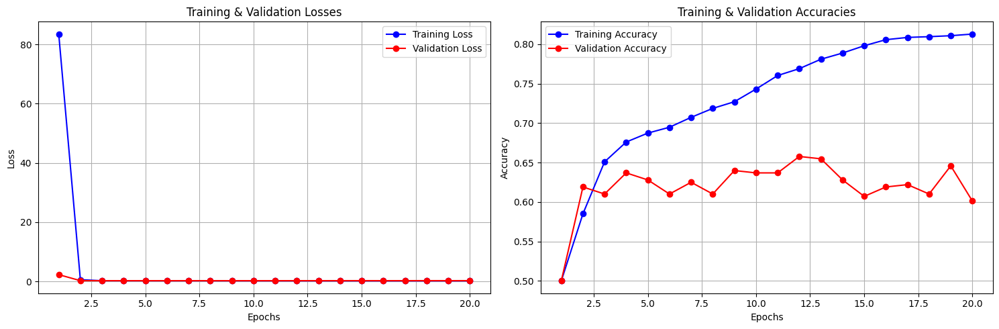

Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |           5735           |           5735           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_rate': 0.01, 'base_model': 'inception_v4', 'margin': 1.0, 'threshold': 0.5, 'max_positive_combinations': 10, 'loss_function': 'contrastive', 'patience': 0, 'lr_sc

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 102.42333539856804 | Epoch Valid Loss: 1430.6008210976918
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.3438415875865353 | Epoch Valid Loss: 4450.188416043918
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.2631410099565983 | Epoch Valid Loss: 289.63771426677704
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.2571985808511575 | Epoch Valid Loss: 1009.8803506741921
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.25356360682182844 | Epoch Valid Loss: 355.4014359811942
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.24826323654916552 | Epoch Valid Loss: 535.7426120365659
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.24501578112443287 | Epoch Valid Loss: 3652.5791910787425
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.23863651239209704 | Epoch Valid Loss: 492.8004271835089
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.2356271792617109 | Epoch Valid Loss: 1036.0863939325016
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.23216912547747295 | Epoch Valid Loss: 2472.986280153195
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.22917494177818298 | Epoch Valid Loss: 380.0052828987439
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.22770523064666323 | Epoch Valid Loss: 475.4029597491026
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.22464142392079037 | Epoch Valid Loss: 193.38575732707977
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.22413894327150452 | Epoch Valid Loss: 591.0128060008088
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.22316301903790897 | Epoch Valid Loss: 1872.073908013602
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.2198446118997203 | Epoch Valid Loss: 274.11339779694873
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.22081102381149928 | Epoch Valid Loss: 597.1265974640846
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.22007698656784164 | Epoch Valid Loss: 517.1160684252778
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.21934068749348323 | Epoch Valid Loss: 1229.4735659261544
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.2169290838142236 | Epoch Valid Loss: 338.0479827870925
####################################################################################################
+--------------------------------------------+
| Model Performance with 'inception_v4' base |
+-------------------+------------------------+
|       Split       |      Accuracy (%)      |
+-------------------+------------------------+
|      Training     |         60.89          |
|     Validation    |         56.50          |
|        Test       |         60.42          |
+-------------------+------------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.59      0.70      0.64       168
Positive Pair       0.63      0.51      0.56       168

     accuracy                           0.60       336
    macro avg       0.61      0.60    

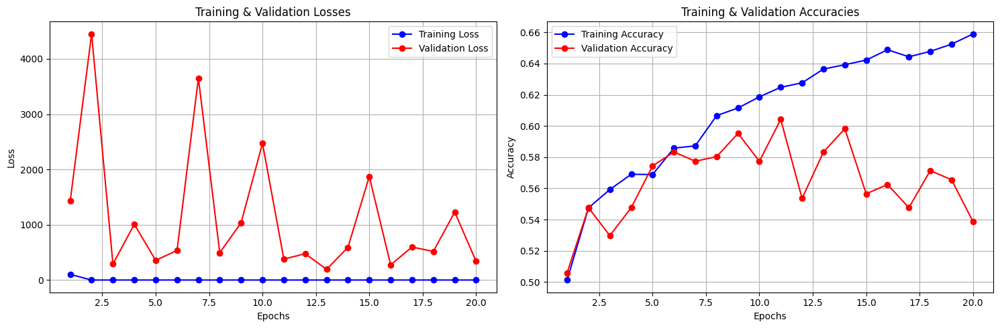

In [38]:
base_models = ['resnet18', 'resnet50', 'efficientnet_b0', 'inception_v4']

table = PrettyTable()
table.field_names = ["Base Model", "Validation Accuracy (%)", "Test Accuracy (%)"]
for base_model in base_models:
    # Update the base model in the hyperparameters
    hyperparameters['base_model'] = base_model
    
    # Train the model using the Siamese_main function
    _, avg_train_accuracy, avg_valid_accuracy, avg_test_accuracy, _ = Siamese_main(hyperparameters, plot_loss=True, disp_preds=False, print_tables=True, visualize=False)
    
    # Add the results to the table
    table.add_row([base_model, f"{avg_valid_accuracy:.2f}", f"{avg_test_accuracy*100:.2f}"])

In [39]:
print(table)

+-----------------+-------------------------+-------------------+
|    Base Model   | Validation Accuracy (%) | Test Accuracy (%) |
+-----------------+-------------------------+-------------------+
|     resnet18    |          67.08          |       63.39       |
|     resnet50    |          64.18          |       61.31       |
| efficientnet_b0 |          61.99          |       62.50       |
|   inception_v4  |          56.50          |       60.42       |
+-----------------+-------------------------+-------------------+


We can see that `resnet18` gives the best results. The `efficientnetb0` is very close in terms of accuracy, but it takes more time to train hence I will fix `resnet18` as the base model for the rest of the ablation studies. 
However, in some experiments, I was able to get remarkable results with `efficientnetb0` as well and sometimes it even outperformed `resnet18`. But fixing base_model as `resnet18` as it takes less time to train.
Also, `resnet50` despite a deeper architecture, performs worse than `resnet18`, `inceptionv4` being older architecture performs the worst.

### Changing Loss Functions <a id="changing-loss-functions"></a>

Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |           5735           |           5735           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_rate': 0.01, 'base_model': 'resnet18', 'margin': 1.0, 'threshold': 0.5, 'max_positive_combinations': 10, 'loss_function': 'BCE', 'patience': 0, 'lr_scheduler': No

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 0.6315453625387616 | Epoch Valid Loss: 0.6171249647935232
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.6018722044097052 | Epoch Valid Loss: 0.6175857981046041
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.5915614651309119 | Epoch Valid Loss: 0.6234670480092367
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.5861480136712393 | Epoch Valid Loss: 0.616735448439916
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.5828406661748886 | Epoch Valid Loss: 0.6181058088938395
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.5807580355140898 | Epoch Valid Loss: 0.6210736831029257
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.5769492935803201 | Epoch Valid Loss: 0.6218228737513224
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.5758023467328813 | Epoch Valid Loss: 0.6203362047672272
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.5774938374757767 | Epoch Valid Loss: 0.6206588844458262
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.5746915171543757 | Epoch Valid Loss: 0.6251347661018372
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.574144368701511 | Epoch Valid Loss: 0.6257893244425455
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.5733590609497494 | Epoch Valid Loss: 0.6301867763201395
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.5729825023147795 | Epoch Valid Loss: 0.6271775662899017
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.5721964458624522 | Epoch Valid Loss: 0.6289437711238861
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.5716809252897899 | Epoch Valid Loss: 0.6273510456085205
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.5720144397682614 | Epoch Valid Loss: 0.6258496145407358
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.5705327987670898 | Epoch Valid Loss: 0.624249001344045
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.5717401772737503 | Epoch Valid Loss: 0.6252279380957285
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.5706910441319147 | Epoch Valid Loss: 0.6282734473546346
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.5691505250003602 | Epoch Valid Loss: 0.6256942550341288
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        73.60         |
|    Validation   |        65.64         |
|       Test      |        62.80         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.59      0.87      0.70       168
Positive Pair       0.75      0.39      0.51       168

     accuracy                           0.63       336
    macro avg       0.67      0.63      0.61       336
 weighted avg     

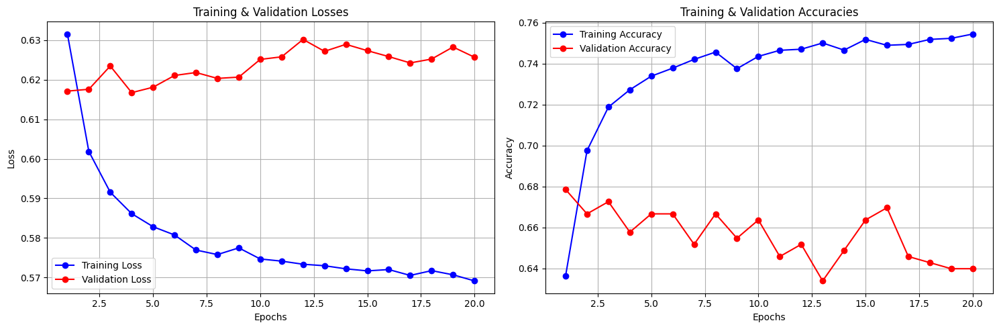

Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |           5735           |           5735           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_rate': 0.01, 'base_model': 'resnet18', 'margin': 1.0, 'threshold': 0.5, 'max_positive_combinations': 10, 'loss_function': 'hinge_loss', 'patience': 0, 'lr_schedul

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 0.6443130926953422 | Epoch Valid Loss: 0.5007681449254354
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.5000707358121872 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.5000000001655684 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.5006200399663713 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.5 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.5 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.5003100199831857 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.5003100199831857 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.49968998034795126 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.4993799603647656 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.5006200399663713 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.5003100199831857 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.49968998034795126 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.49968998034795126 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.5012400796016058 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.5 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.5003100199831857 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.4993799603647656 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.5 | Epoch Valid Loss: 0.5
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.5006200399663713 | Epoch Valid Loss: 0.5
####################################################################################################


/raid/biplab/phduser1/Munish/envs/EE_782/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/raid/biplab/phduser1/Munish/envs/EE_782/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/raid/biplab/phduser1/Munish/envs/EE_782/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier

+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        50.35         |
|    Validation   |        50.00         |
|       Test      |        50.00         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.00      0.00      0.00       168
Positive Pair       0.50      1.00      0.67       168

     accuracy                           0.50       336
    macro avg       0.25      0.50      0.33       336
 weighted avg       0.25      0.50      0.33       336



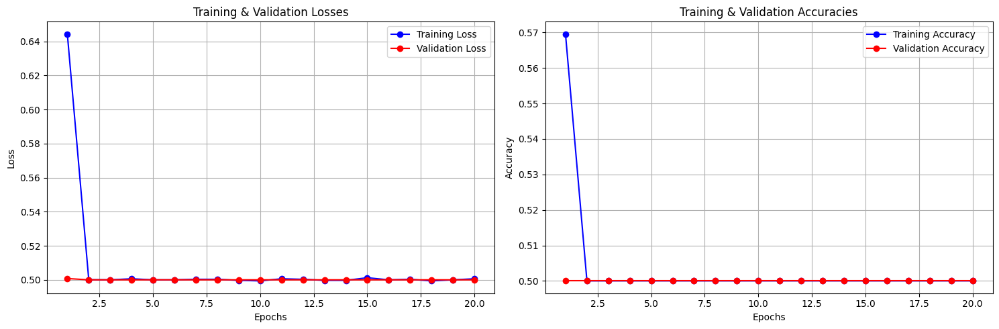

Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |           5735           |           5735           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_rate': 0.01, 'base_model': 'resnet18', 'margin': 1.0, 'threshold': 0.5, 'max_positive_combinations': 10, 'loss_function': 'contrastive', 'patience': 0, 'lr_schedu

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 81.69360491550631 | Epoch Valid Loss: 2.5700027545293174
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.574039084215959 | Epoch Valid Loss: 0.22350883980592093
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.21246472489502694 | Epoch Valid Loss: 0.2106189876794815
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.20684799841708607 | Epoch Valid Loss: 0.20521740118662515
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.20244120814734035 | Epoch Valid Loss: 0.19908025860786438
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.19783097919490603 | Epoch Valid Loss: 0.19773120184739432
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.194294829832183 | Epoch Valid Loss: 0.1997437576452891
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.19160207559665043 | Epoch Valid Loss: 0.19710303097963333
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.18870071454180612 | Epoch Valid Loss: 0.196087380250295
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.18600668186942737 | Epoch Valid Loss: 0.198283222814401
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.1839217842453056 | Epoch Valid Loss: 0.19958134492238364
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.18099467878540357 | Epoch Valid Loss: 0.1990000158548355
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.17951479057470957 | Epoch Valid Loss: 0.19739962120850882
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.17776003844208188 | Epoch Valid Loss: 0.1981732944647471
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.1765033859345648 | Epoch Valid Loss: 0.1963810995221138
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.1763475881682502 | Epoch Valid Loss: 0.19349373628695807
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.1757373174859418 | Epoch Valid Loss: 0.1992050309975942
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.17620530368553267 | Epoch Valid Loss: 0.1997495119770368
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.17401190424958865 | Epoch Valid Loss: 0.19762088606754938
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.17324341345164512 | Epoch Valid Loss: 0.19732690354188284
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        71.25         |
|    Validation   |        69.08         |
|       Test      |        68.15         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.67      0.73      0.70       168
Positive Pair       0.70      0.64      0.67       168

     accuracy                           0.68       336
    macro avg       0.68      0.68      0.68       336
 weighted avg   

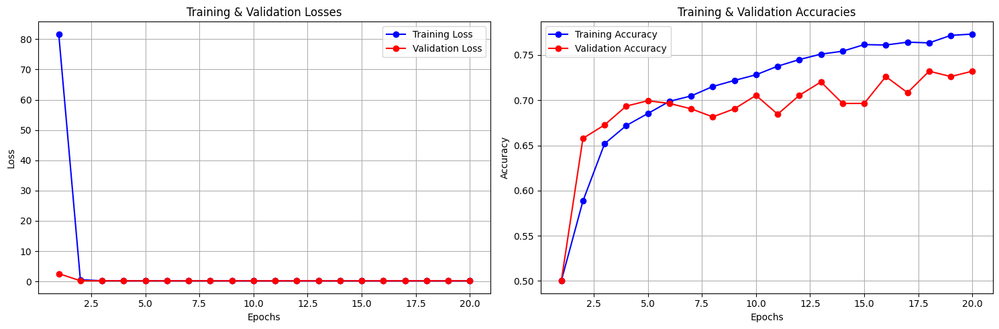

In [43]:
loss_functions = ['BCE', 'hinge_loss', 'contrastive']
table = PrettyTable()
table.field_names = ["Loss Function", "Validation Accuracy (%)", "Test Accuracy (%)"]

for loss_function in loss_functions:
    hyperparameters['loss_function'] = loss_function
    
    # Train the model using the Siamese_main function
    _, avg_train_accuracy, avg_valid_accuracy, avg_test_accuracy, _ = Siamese_main(hyperparameters, plot_loss=True, disp_preds=False, print_tables=True, visualize=False)
    
    # Add the results to the table
    table.add_row([loss_function, f"{avg_valid_accuracy:.2f}", f"{avg_test_accuracy*100:.2f}"])

In [44]:
print(table)

+---------------+-------------------------+-------------------+
| Loss Function | Validation Accuracy (%) | Test Accuracy (%) |
+---------------+-------------------------+-------------------+
|      BCE      |          65.64          |       62.80       |
|   hinge_loss  |          50.00          |       50.00       |
|  contrastive  |          69.08          |       68.15       |
+---------------+-------------------------+-------------------+


We can see smooth loss curves when using `contrastive` loss, whereas `BCE` and `hinge` loss have a lot of fluctuations. Also, `contrastive` loss gives the best results in terms of accuracy. Therefore, I will fix `contrastive` loss for the rest of the ablation studies. `Binary Cross-Entropy (BCE)` could also be another viable option, but it is not as stable as `contrastive` loss.

### Changing Number of Augmentations <a id="applying-data-augmentation"></a>

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 1 = 4069
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |           5413           |           5413           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_rate': 0.01, 'base_mode

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 64.81130120964612 | Epoch Valid Loss: 3.316296418507894
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.38004325781674947 | Epoch Valid Loss: 0.23899573336044946
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.1630406965227688 | Epoch Valid Loss: 0.2307526965936025
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.15969924773363506 | Epoch Valid Loss: 0.22294005999962488
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.1581670404795338 | Epoch Valid Loss: 0.2203111598889033
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.1559972522451597 | Epoch Valid Loss: 0.21979488680760065
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.15385394442607375 | Epoch Valid Loss: 0.2209508866071701
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.15008380868855645 | Epoch Valid Loss: 0.21134465436140695
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.14893639876562006 | Epoch Valid Loss: 0.2169164518515269
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.14657948713968783 | Epoch Valid Loss: 0.2111069584886233
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.14384967228945564 | Epoch Valid Loss: 0.2079329490661621
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.14225205389015816 | Epoch Valid Loss: 0.2067392940322558
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.1399248830097563 | Epoch Valid Loss: 0.20389727503061295
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.13888776350547286 | Epoch Valid Loss: 0.20042917629082999
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.1389841433833627 | Epoch Valid Loss: 0.20142551014820734
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.1371095806798514 | Epoch Valid Loss: 0.2094475974639257
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.13751719160115017 | Epoch Valid Loss: 0.19909365475177765
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.1362721575971912 | Epoch Valid Loss: 0.20452961325645447
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.13686982586103327 | Epoch Valid Loss: 0.2073349878191948
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.13714674084502107 | Epoch Valid Loss: 0.20520884792009988
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        81.14         |
|    Validation   |        63.04         |
|       Test      |        64.58         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.60      0.85      0.70       168
Positive Pair       0.74      0.45      0.56       168

     accuracy                           0.65       336
    macro avg       0.67      0.65      0.63       336
 weighted avg   

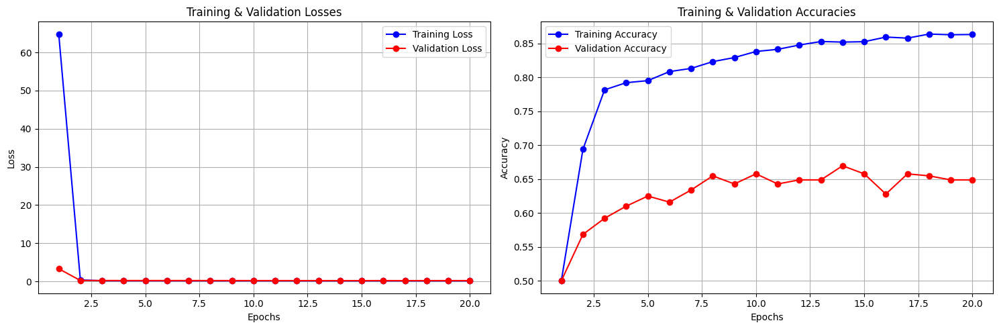

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 2 = 8138
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |           9482           |           9482           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_rate': 0.01, 'base_mode

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 33.76097399452921 | Epoch Valid Loss: 0.2395262693365415
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.151618378556738 | Epoch Valid Loss: 0.2387687067190806
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.14760165297824526 | Epoch Valid Loss: 0.24839945137500763
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.14479101481863144 | Epoch Valid Loss: 0.2455291599035263
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.14158370308201723 | Epoch Valid Loss: 0.2404799610376358
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.13822594147037576 | Epoch Valid Loss: 0.2407688001791636
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.13588656999346382 | Epoch Valid Loss: 0.23555592447519302
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.13362048563832787 | Epoch Valid Loss: 0.2405459607640902
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.13258880908641751 | Epoch Valid Loss: 0.23532207806905112
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.13185192835250686 | Epoch Valid Loss: 0.24386976410945257
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.13162085406406962 | Epoch Valid Loss: 0.2288515269756317
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.1315993578094826 | Epoch Valid Loss: 0.24552770207325617
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.13123594761296153 | Epoch Valid Loss: 0.23092980682849884
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.13041138202453703 | Epoch Valid Loss: 0.2262257312734922
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.13065825342529952 | Epoch Valid Loss: 0.24325707058111826
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.1299332604063079 | Epoch Valid Loss: 0.2222209001580874
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.12994972972657143 | Epoch Valid Loss: 0.2271742820739746
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.129617065015666 | Epoch Valid Loss: 0.24021421621243158
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.1306246212536237 | Epoch Valid Loss: 0.24916308373212814
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.12958778493633175 | Epoch Valid Loss: 0.23800459255774817
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        84.92         |
|    Validation   |        60.21         |
|       Test      |        61.61         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.58      0.87      0.69       168
Positive Pair       0.73      0.36      0.49       168

     accuracy                           0.62       336
    macro avg       0.66      0.62      0.59       336
 weighted avg   

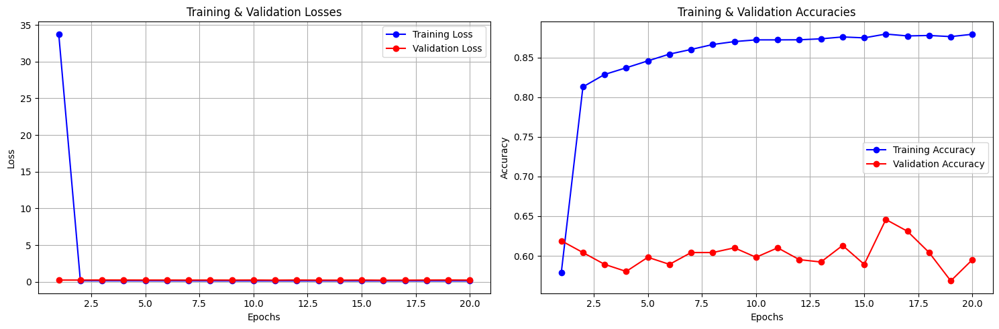

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          17620           |          17620           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_rate': 0.01, 'base_mod

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 17.777699431752662 | Epoch Valid Loss: 0.2444241245587667
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.14082095945108608 | Epoch Valid Loss: 0.24214396625757217
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.13554546499317224 | Epoch Valid Loss: 0.25040704508622486
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.1308944508460386 | Epoch Valid Loss: 0.23586001992225647
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.1282550535568741 | Epoch Valid Loss: 0.24155899633963904
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.12672556138947308 | Epoch Valid Loss: 0.2392587661743164
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.12667819044929668 | Epoch Valid Loss: 0.2343874822060267
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.12613155617093003 | Epoch Valid Loss: 0.2366073578596115
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.12598088548642106 | Epoch Valid Loss: 0.23211589455604553
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.12591682064825307 | Epoch Valid Loss: 0.2399606928229332
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.12560156389340732 | Epoch Valid Loss: 0.2474076822400093
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.12571900524537058 | Epoch Valid Loss: 0.24100350588560104
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.12565800383984502 | Epoch Valid Loss: 0.2300656040509542
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.12610867887248578 | Epoch Valid Loss: 0.2268807664513588
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.12502818710141952 | Epoch Valid Loss: 0.23180868228276572
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.12595479428335457 | Epoch Valid Loss: 0.22725450495878854
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.12646701296422963 | Epoch Valid Loss: 0.23507426182428995
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.12640563222814602 | Epoch Valid Loss: 0.22779621680577597
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.12625307238199318 | Epoch Valid Loss: 0.2269503896435102
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.12602708119554226 | Epoch Valid Loss: 0.23290443420410156
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        87.09         |
|    Validation   |        60.91         |
|       Test      |        62.20         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.58      0.92      0.71       168
Positive Pair       0.80      0.33      0.46       168

     accuracy                           0.62       336
    macro avg       0.69      0.62      0.59       336
 weighted avg   

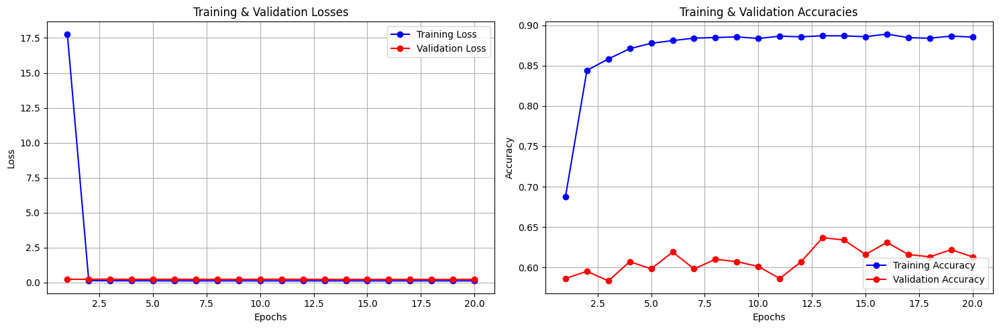

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_rate': 0.01, 'base_mod

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 15.106920643493014 | Epoch Valid Loss: 0.22182244310776392
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.15920981200585185 | Epoch Valid Loss: 0.21784366915623346
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.15346518861736322 | Epoch Valid Loss: 0.20822862287362418
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.15001831852376116 | Epoch Valid Loss: 0.20643454045057297
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.14817648998266736 | Epoch Valid Loss: 0.21388466904560724
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.14766551951639528 | Epoch Valid Loss: 0.21173743406931558
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.14703680234852917 | Epoch Valid Loss: 0.2116194243232409
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.1467805278899018 | Epoch Valid Loss: 0.21266366789738336
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.1468204455666764 | Epoch Valid Loss: 0.2166385774811109
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.14693365132349523 | Epoch Valid Loss: 0.20961851874987283
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.1466240485112161 | Epoch Valid Loss: 0.21875571211179098
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.14697676472539126 | Epoch Valid Loss: 0.2110287348429362
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.14728237471954767 | Epoch Valid Loss: 0.20341849823792776
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.14751638342128243 | Epoch Valid Loss: 0.25472845882177353
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.14732024357329274 | Epoch Valid Loss: 0.20689225445191065
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.14729420862398868 | Epoch Valid Loss: 0.20564855883518854
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.14715685837274028 | Epoch Valid Loss: 0.21154803782701492
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.14743473710015761 | Epoch Valid Loss: 0.20435050378243128
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.14753776501734242 | Epoch Valid Loss: 0.2081539904077848
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.14643692200310354 | Epoch Valid Loss: 0.2067883387207985
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        82.53         |
|    Validation   |        65.27         |
|       Test      |        66.37         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.64      0.75      0.69       168
Positive Pair       0.70      0.58      0.63       168

     accuracy                           0.66       336
    macro avg       0.67      0.66      0.66       336
 weighted avg    

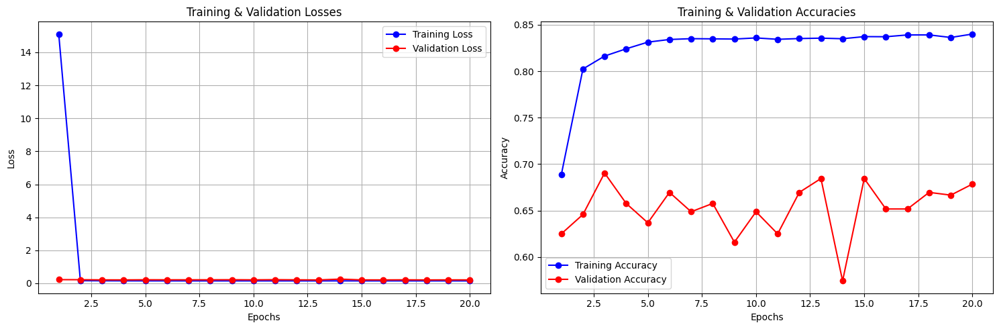

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 6 = 24414
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          32509           |          32509           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_rate': 0.01, 'base_mod

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 10.694812098642679 | Epoch Valid Loss: 0.20546441276868185
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.15504460782545992 | Epoch Valid Loss: 0.2014229695002238
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.14906971723457255 | Epoch Valid Loss: 0.21046344190835953
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.14765708382410092 | Epoch Valid Loss: 0.21015267570813498
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.14690625165244492 | Epoch Valid Loss: 0.20467636982599893
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.14675038862298792 | Epoch Valid Loss: 0.2011131172378858
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.14694644052417963 | Epoch Valid Loss: 0.20611693958441415
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.14669635180589252 | Epoch Valid Loss: 0.1970246434211731
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.14759739831559301 | Epoch Valid Loss: 0.22437955935796103
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.14741699503162714 | Epoch Valid Loss: 0.2069734757145246
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.14748092566242837 | Epoch Valid Loss: 0.21194036801656088
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.14780960109554173 | Epoch Valid Loss: 0.2118042434255282
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.1467336017169117 | Epoch Valid Loss: 0.21264309932788214
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.14736843700924024 | Epoch Valid Loss: 0.20499889304240546
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.14655916230738397 | Epoch Valid Loss: 0.20398671925067902
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.14618079815294563 | Epoch Valid Loss: 0.20656652996937433
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.14542861802019472 | Epoch Valid Loss: 0.206445982058843
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.1458171495111791 | Epoch Valid Loss: 0.20904625952243805
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.14583007229389403 | Epoch Valid Loss: 0.20849981904029846
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.14509061565549355 | Epoch Valid Loss: 0.22768584390481314
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        83.00         |
|    Validation   |        66.44         |
|       Test      |        59.23         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.56      0.90      0.69       168
Positive Pair       0.74      0.29      0.41       168

     accuracy                           0.59       336
    macro avg       0.65      0.59      0.55       336
 weighted avg   

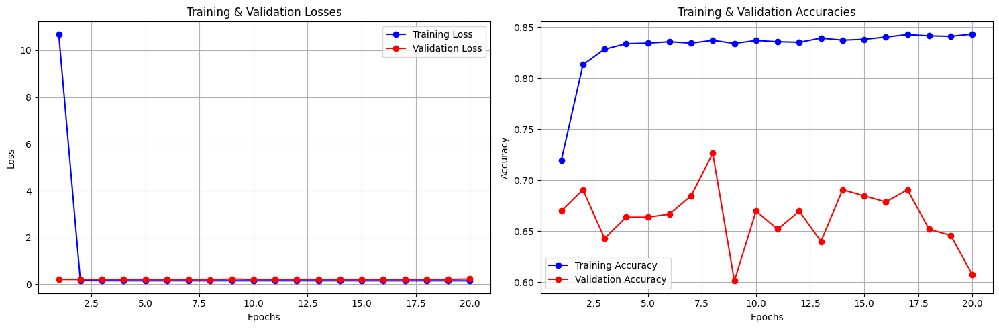

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 10 = 40690
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          53342           |          53342           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_rate': 0.01, 'base_mo

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 6.846174319404897 | Epoch Valid Loss: 0.21303667624791464
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.14879643719533853 | Epoch Valid Loss: 0.20300699025392532
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.14649246365332502 | Epoch Valid Loss: 0.20408502221107483
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.14610126180139643 | Epoch Valid Loss: 0.21403549363215765
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.1458896706713197 | Epoch Valid Loss: 0.20181967318058014
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.14722648916858788 | Epoch Valid Loss: 0.2013718237479528
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.14701471806698813 | Epoch Valid Loss: 0.20260866979757944
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.14677570625272568 | Epoch Valid Loss: 0.21471094836791357
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.14620511395153915 | Epoch Valid Loss: 0.21002212911844254
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.145917713038744 | Epoch Valid Loss: 0.2079558769861857
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.14541770718951533 | Epoch Valid Loss: 0.20434504002332687
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.14575080785857894 | Epoch Valid Loss: 0.2247927561402321
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.14475223064047174 | Epoch Valid Loss: 0.20468305299679437
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.1451774230511802 | Epoch Valid Loss: 0.23248920838038126
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.14512037054088636 | Epoch Valid Loss: 0.22496858735879263
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.14482992488374663 | Epoch Valid Loss: 0.22443559020757675
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.1445147646630175 | Epoch Valid Loss: 0.20799936602512994
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.14443744117886848 | Epoch Valid Loss: 0.20161807785431543
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.14394834437410348 | Epoch Valid Loss: 0.2049571176369985
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.1440935085947169 | Epoch Valid Loss: 0.20856649428606033
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        83.50         |
|    Validation   |        64.88         |
|       Test      |        65.18         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.60      0.93      0.73       168
Positive Pair       0.85      0.37      0.51       168

     accuracy                           0.65       336
    macro avg       0.72      0.65      0.62       336
 weighted avg    

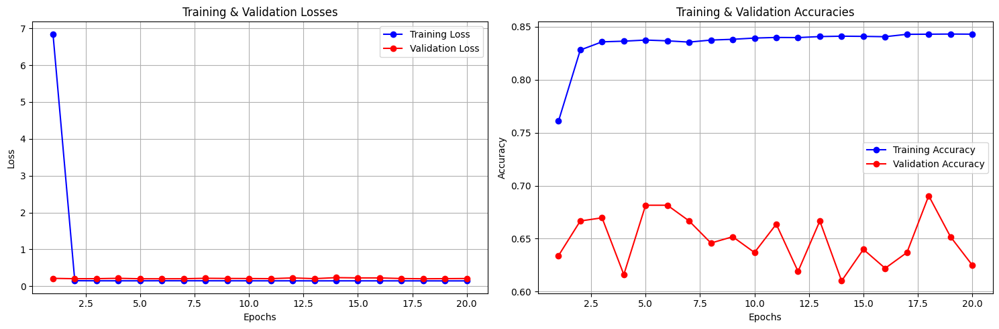

In [46]:
num_augmentations = [1, 2, 4, 4, 6, 10]
max_positive_combinations = [1, 1, 1, 10, 20, 50]
table = PrettyTable()
table.field_names = ["Number of Augmented Images per person", "Max Positive Combinations", "Validation Accuracy (%)", "Test Accuracy (%)"]

for aug, comb in zip(num_augmentations, max_positive_combinations):
    # Update num_augmentations and max_positive_combinations in the hyperparameters
    hyperparameters['apply_augmentation'] = True
    hyperparameters['num_augmentations'] = aug
    hyperparameters['max_positive_combinations'] = comb
     
    # Train the model using the Siamese_main function
    _, avg_train_accuracy, avg_valid_accuracy, avg_test_accuracy, _ = Siamese_main(hyperparameters, plot_loss=True, disp_preds=False, print_tables=True, visualize=False)
    
    # Add the results to the table
    table.add_row([aug, comb, f"{avg_valid_accuracy:.2f}", f"{avg_test_accuracy*100:.2f}"])

In [47]:
print(table)

+---------------------------------------+---------------------------+-------------------------+-------------------+
| Number of Augmented Images per person | Max Positive Combinations | Validation Accuracy (%) | Test Accuracy (%) |
+---------------------------------------+---------------------------+-------------------------+-------------------+
|                   1                   |             1             |          63.04          |       64.58       |
|                   2                   |             1             |          60.21          |       61.61       |
|                   4                   |             1             |          60.91          |       62.20       |
|                   4                   |             10            |          65.27          |       66.37       |
|                   6                   |             20            |          66.44          |       59.23       |
|                   10                  |             50            |   

This cell took a lot of time to train, since I have to train 6 models, Here we can note that as we increase the `max_positive_combinations` from 1 to 10 (keeping `num_augmentations`=4 as fixed), there is a clear increase in both the validation and test accuracy, Hence I will fix `max_positive_combinations` as 10 for the rest of the ablation studies. Also, increasing the number of augmented images per person to a very large value like 10, doesn't help much, hence I will fix `num_augmentations` as 4 for the rest of the ablation studies.

### Changing Number of Layers to Freeze <a id="changing-number-of-layers-to-freeze"></a>

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 16.240790900828447 | Epoch Valid Loss: 0.21784192075332007
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.16017372533679008 | Epoch Valid Loss: 0.21115225305159888
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.15369268817567203 | Epoch Valid Loss: 0.20453291883071265
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.14987246393291062 | Epoch Valid Loss: 0.2022396276394526
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.14733373000134908 | Epoch Valid Loss: 0.20898618549108505
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.14775932899697922 | Epoch Valid Loss: 0.20361902316411337
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.14714232416347015 | Epoch Valid Loss: 0.20308280239502588
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.14672352872832223 | Epoch Valid Loss: 0.2038808340827624
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.14689405743292597 | Epoch Valid Loss: 0.2095847874879837
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.14629157718141064 | Epoch Valid Loss: 0.2062898874282837
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.14612973881019062 | Epoch Valid Loss: 0.20306172470251718
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.14671131539656673 | Epoch Valid Loss: 0.20515100161234537
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.1454911869409126 | Epoch Valid Loss: 0.21966873357693353
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.14806776041121678 | Epoch Valid Loss: 0.2039457162221273
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.14714256112008942 | Epoch Valid Loss: 0.20893743634223938
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.14757434589528415 | Epoch Valid Loss: 0.20639680325984955
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.14730945280428195 | Epoch Valid Loss: 0.21867909779151282
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.1470755770975767 | Epoch Valid Loss: 0.20373091598351797
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.14753038387442396 | Epoch Valid Loss: 0.20813017586867014
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.14641655441157 | Epoch Valid Loss: 0.2064696749051412
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        82.52         |
|    Validation   |        65.91         |
|       Test      |        65.77         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.62      0.79      0.70       168
Positive Pair       0.72      0.52      0.60       168

     accuracy                           0.66       336
    macro avg       0.67      0.66      0.65       336
 weighted avg       

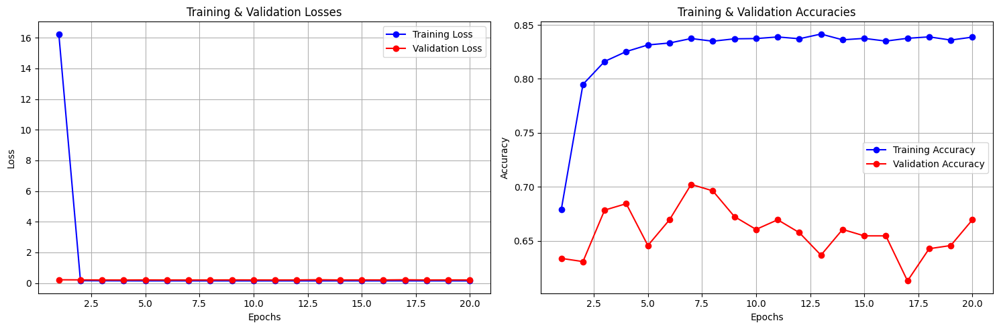

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 16.488892185306828 | Epoch Valid Loss: 0.22516759981711706
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.15942920559237517 | Epoch Valid Loss: 0.22638505697250366
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.1533452501672125 | Epoch Valid Loss: 0.2100114425023397
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.1494907238304095 | Epoch Valid Loss: 0.2154015600681305
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.14728149663397047 | Epoch Valid Loss: 0.21533616135517755
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.14656061724608027 | Epoch Valid Loss: 0.21567146480083466
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.1465612031129557 | Epoch Valid Loss: 0.21199576556682587
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.14649785920804323 | Epoch Valid Loss: 0.21234288066625595
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.14601660373642347 | Epoch Valid Loss: 0.21509556223948798
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.14546890035921403 | Epoch Valid Loss: 0.22068288922309875
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.14548714425371484 | Epoch Valid Loss: 0.21231042593717575
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.14541957763478505 | Epoch Valid Loss: 0.2132763663927714
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.14607508379836068 | Epoch Valid Loss: 0.2080602819720904
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.1465549490327925 | Epoch Valid Loss: 0.22814728567997614
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.14711943902291877 | Epoch Valid Loss: 0.23435487101475397
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.14688124346308584 | Epoch Valid Loss: 0.21930811802546182
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.14630025143323597 | Epoch Valid Loss: 0.21370457857847214
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.14661545975696902 | Epoch Valid Loss: 0.21651549637317657
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.14659386525623674 | Epoch Valid Loss: 0.2265625149011612
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.14557685352168803 | Epoch Valid Loss: 0.206646037598451
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        82.61         |
|    Validation   |        63.79         |
|       Test      |        65.18         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.61      0.82      0.70       168
Positive Pair       0.73      0.48      0.58       168

     accuracy                           0.65       336
    macro avg       0.67      0.65      0.64       336
 weighted avg     

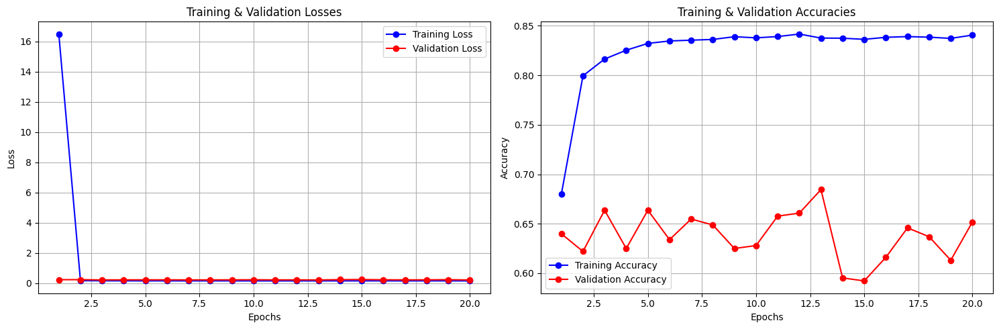

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 13.208167601041062 | Epoch Valid Loss: 0.2230451156695684
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.13891775414434282 | Epoch Valid Loss: 0.20817175755898157
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.12301689947327209 | Epoch Valid Loss: 0.1974130558470885
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.11175219704895172 | Epoch Valid Loss: 0.16956440856059393
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.10106929495584133 | Epoch Valid Loss: 0.1635400801897049
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.09261296579592623 | Epoch Valid Loss: 0.16491161286830902
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.0840370080401298 | Epoch Valid Loss: 0.16685519615809122
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.07485539717383163 | Epoch Valid Loss: 0.15974214300513268
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.06754172790449026 | Epoch Valid Loss: 0.15690152967969576
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.06143110760400981 | Epoch Valid Loss: 0.15475435430804887
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.055454481103414194 | Epoch Valid Loss: 0.14578293884793916
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.051136008147041986 | Epoch Valid Loss: 0.16035772239168486
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.04763228251046479 | Epoch Valid Loss: 0.141608826816082
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.04521255837320242 | Epoch Valid Loss: 0.14492681870857874
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.04412165466360315 | Epoch Valid Loss: 0.14341924836238226
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.04181854938817492 | Epoch Valid Loss: 0.16087106615304947
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.041321225299196705 | Epoch Valid Loss: 0.14112099508444467
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.04052998939377451 | Epoch Valid Loss: 0.14189844826857248
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.03941509792808617 | Epoch Valid Loss: 0.16851260513067245
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.03857475042148212 | Epoch Valid Loss: 0.15823262433211008
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        93.35         |
|    Validation   |        75.33         |
|       Test      |        74.40         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.68      0.93      0.78       168
Positive Pair       0.89      0.56      0.69       168

     accuracy                           0.74       336
    macro avg       0.78      0.74      0.74       336
 weighted avg   

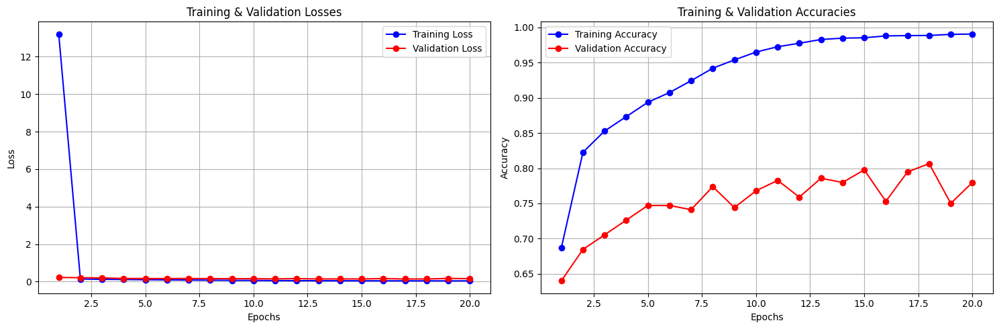

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 13.397166578250742 | Epoch Valid Loss: 0.24390016247828802
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.13696263304933212 | Epoch Valid Loss: 0.19271139055490494
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.12107417337206561 | Epoch Valid Loss: 0.18255230287710825
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.11001597949693542 | Epoch Valid Loss: 0.1597577507297198
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.10050975825356016 | Epoch Valid Loss: 0.15868110209703445
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.09307369029929125 | Epoch Valid Loss: 0.13871049135923386
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.08545045390032059 | Epoch Valid Loss: 0.1313762292265892
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.07838512340365628 | Epoch Valid Loss: 0.12491956229011218
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.0712619350335106 | Epoch Valid Loss: 0.13097731148203215
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.06446092507022239 | Epoch Valid Loss: 0.12562483797470728
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.05818346253498782 | Epoch Valid Loss: 0.13376886025071144
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.052671472436401905 | Epoch Valid Loss: 0.12326054895917575
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.048206420861682746 | Epoch Valid Loss: 0.1260028233130773
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.04376221037751367 | Epoch Valid Loss: 0.12587255736192068
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.041573437036361634 | Epoch Valid Loss: 0.12388703475395839
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.03952112746814829 | Epoch Valid Loss: 0.1341924841205279
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.03879747615022541 | Epoch Valid Loss: 0.130903081347545
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.037937902536806324 | Epoch Valid Loss: 0.13158382723728815
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.03805493213355455 | Epoch Valid Loss: 0.13400359451770782
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.03687651471375639 | Epoch Valid Loss: 0.14767440408468246
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        92.59         |
|    Validation   |        79.57         |
|       Test      |        78.57         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.72      0.93      0.81       168
Positive Pair       0.91      0.64      0.75       168

     accuracy                           0.79       336
    macro avg       0.81      0.79      0.78       336
 weighted avg   

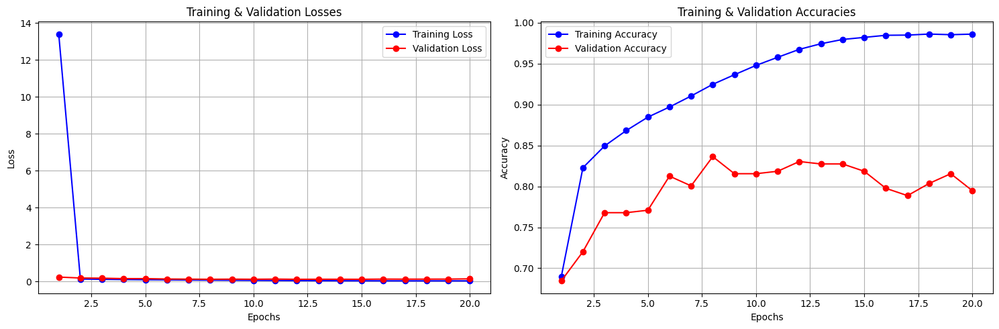

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 14.615965149267902 | Epoch Valid Loss: 0.22437234222888947
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.14218903350275616 | Epoch Valid Loss: 0.22935251146554947
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.12817719502937655 | Epoch Valid Loss: 0.20214339097340903
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.11769416549264691 | Epoch Valid Loss: 0.19511759281158447
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.10744788198796816 | Epoch Valid Loss: 0.19359390437602997
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.09946426633355576 | Epoch Valid Loss: 0.18158979217211405
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.09167361366670838 | Epoch Valid Loss: 0.1637413129210472
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.08418132995558512 | Epoch Valid Loss: 0.14458361888925234
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.07705140233494688 | Epoch Valid Loss: 0.15209969878196716
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.07011855794874908 | Epoch Valid Loss: 0.13780542959769568
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.06344409330834656 | Epoch Valid Loss: 0.1449727565050125
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.05711001520001784 | Epoch Valid Loss: 0.1389707215130329
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.052975260227550426 | Epoch Valid Loss: 0.1289905682206154
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.04901823096876141 | Epoch Valid Loss: 0.13291902095079422
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.04595822629486319 | Epoch Valid Loss: 0.13956019654870033
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.04333331577241594 | Epoch Valid Loss: 0.14262199153502783
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.04285404354409683 | Epoch Valid Loss: 0.13424827034274736
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.042533792555332184 | Epoch Valid Loss: 0.13124589125315347
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.041852084557027665 | Epoch Valid Loss: 0.11700255920489629
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.04070108250151713 | Epoch Valid Loss: 0.12990283221006393
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        91.40         |
|    Validation   |        76.61         |
|       Test      |        82.14         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.77      0.92      0.84       168
Positive Pair       0.90      0.73      0.80       168

     accuracy                           0.82       336
    macro avg       0.83      0.82      0.82       336
 weighted avg   

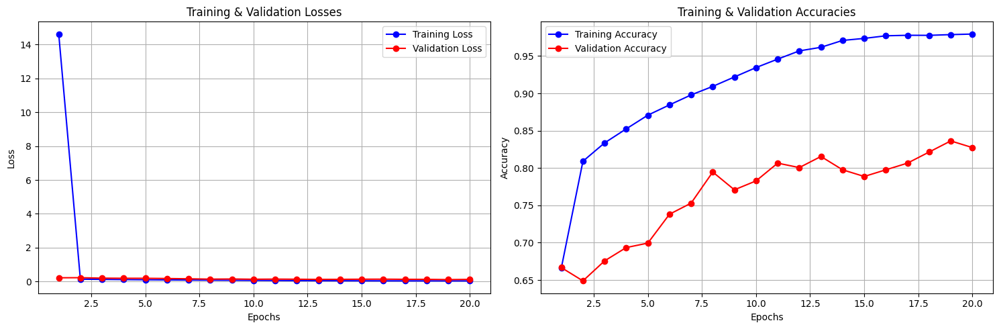

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 16.368837366400417 | Epoch Valid Loss: 0.3665771633386612
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.17400995014928455 | Epoch Valid Loss: 0.29932111501693726
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.14873458315120186 | Epoch Valid Loss: 0.2848658934235573
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.13653824909395257 | Epoch Valid Loss: 0.2692165821790695
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.12707464678516223 | Epoch Valid Loss: 0.2570708592732747
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.12012604538481249 | Epoch Valid Loss: 0.24955451985200247
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.11362692834484543 | Epoch Valid Loss: 0.26780930161476135
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.10738056920858663 | Epoch Valid Loss: 0.24336378027995428
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.10098850576553581 | Epoch Valid Loss: 0.2298831343650818
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.09458868360948251 | Epoch Valid Loss: 0.2314865862329801
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.08831162821111638 | Epoch Valid Loss: 0.24694609642028809
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.08201181283762116 | Epoch Valid Loss: 0.22166654964288077
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.07606252268238296 | Epoch Valid Loss: 0.20476852605740228
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.07049971034338828 | Epoch Valid Loss: 0.20675345261891684
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.06592999186453431 | Epoch Valid Loss: 0.20947674910227457
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.0634060294887181 | Epoch Valid Loss: 0.19744445631901422
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.0600075532714728 | Epoch Valid Loss: 0.23730148126681647
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.057205195879823596 | Epoch Valid Loss: 0.22234486043453217
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.053434903928360276 | Epoch Valid Loss: 0.1907088334361712
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.05137674791770879 | Epoch Valid Loss: 0.18780687699715296
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        88.07         |
|    Validation   |        67.22         |
|       Test      |        70.54         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.64      0.92      0.76       168
Positive Pair       0.86      0.49      0.62       168

     accuracy                           0.71       336
    macro avg       0.75      0.71      0.69       336
 weighted avg   

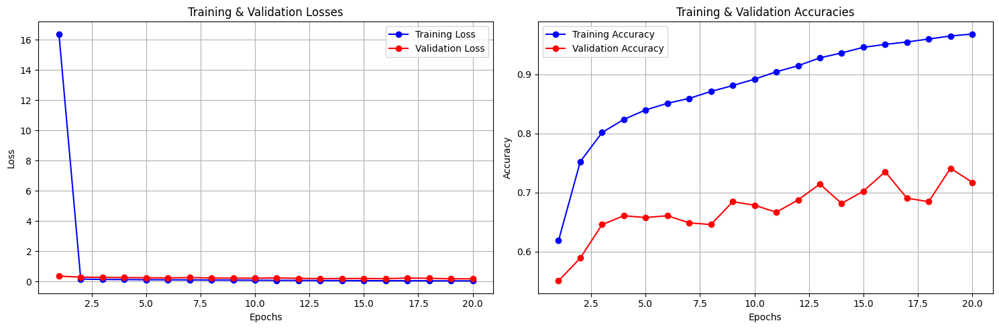

In [25]:
unfreeze_last_n = [0, 1, 2, 3, 4, -1]
table = PrettyTable()
table.field_names = ["Number of Layers unfreezed from the end", "Validation Accuracy (%)", "Test Accuracy (%)"]
for n in unfreeze_last_n:
    # Update the base model in the hyperparameters
    hyperparameters['unfreeze_last_n'] = n
    
    # Train the model using the Siamese_main function
    _, avg_train_accuracy, avg_valid_accuracy, avg_test_accuracy, _ = Siamese_main(hyperparameters, plot_loss=True, disp_preds=False, print_tables=True, visualize=False)
    
    # Add the results to the table
    table.add_row([n, f"{avg_valid_accuracy:.2f}", f"{avg_test_accuracy*100:.2f}"])

In [26]:
print(table)

+-----------------------------------------+-------------------------+-------------------+
| Number of Layers unfreezed from the end | Validation Accuracy (%) | Test Accuracy (%) |
+-----------------------------------------+-------------------------+-------------------+
|                    0                    |          65.91          |       65.77       |
|                    1                    |          63.79          |       65.18       |
|                    2                    |          75.33          |       74.40       |
|                    3                    |          79.57          |       78.57       |
|                    4                    |          76.61          |       82.14       |
|                    -1                   |          67.22          |       70.54       |
+-----------------------------------------+-------------------------+-------------------+


Keeping the `unfreeze_last_n` as 4, gave me the highest possible accuracy that I could achieve till now. This hyperparameter works good for `resnet18` and may change if we change the base model. Hence, I will fix `unfreeze_last_n` as 4 for the rest of the ablation studies.

### Changing Regularization Techniques <a id="changing-regularization-techniques"></a>
> <font color="gray">Q6b. Experiment with a regularization technique and its hyper-parameter</font>

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 15.221306969898992 | Epoch Valid Loss: 0.25197861591974896
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.14675901254075904 | Epoch Valid Loss: 0.2103633756438891
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.129610188012986 | Epoch Valid Loss: 0.2212937424580256
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.1208223357016957 | Epoch Valid Loss: 0.2145401562253634
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.11399177047640605 | Epoch Valid Loss: 0.21712691833575568
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.11262637688670048 | Epoch Valid Loss: 0.20824342966079712
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.11218538485619045 | Epoch Valid Loss: 0.18446609874566397
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.11745969026869293 | Epoch Valid Loss: 0.2134606589873632
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.125030588499422 | Epoch Valid Loss: 0.1883003165324529
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.13104427660014048 | Epoch Valid Loss: 0.2338072434067726
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.13841160171297054 | Epoch Valid Loss: 0.22222530841827393
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.1391951683583821 | Epoch Valid Loss: 0.24732809762159982
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.13488160044517974 | Epoch Valid Loss: 0.2487309748927752
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.13091847929713685 | Epoch Valid Loss: 0.2481456051270167
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.12923079670601806 | Epoch Valid Loss: 0.21233311543862024
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.12993745803616422 | Epoch Valid Loss: 0.21675132711728415
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.12833969883057614 | Epoch Valid Loss: 0.1978109652797381
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.1252042571147687 | Epoch Valid Loss: 0.20005891720453897
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.12591158486577833 | Epoch Valid Loss: 0.22513140241305032
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.1253198994280294 | Epoch Valid Loss: 0.2283531352877617
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        82.93         |
|    Validation   |        67.11         |
|       Test      |        63.39         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.59      0.87      0.70       168
Positive Pair       0.75      0.40      0.52       168

     accuracy                           0.63       336
    macro avg       0.67      0.63      0.61       336
 weighted avg     

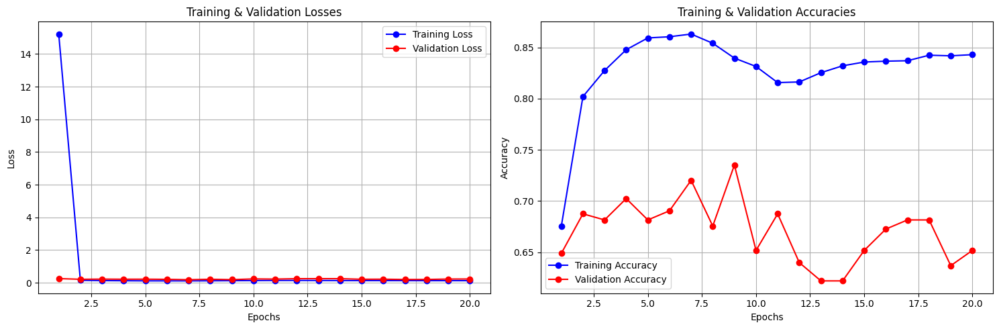

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 13.764564819558155 | Epoch Valid Loss: 0.2756073946754138
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.16942427135180943 | Epoch Valid Loss: 0.24732832610607147
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.14348956158514634 | Epoch Valid Loss: 0.22988507648309073
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.12965034842924322 | Epoch Valid Loss: 0.23776382704575857
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.12045435495349731 | Epoch Valid Loss: 0.24735307693481445
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.11335676648589067 | Epoch Valid Loss: 0.23599953949451447
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.10592960072464722 | Epoch Valid Loss: 0.22504335145155588
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.09939253078990204 | Epoch Valid Loss: 0.21437929570674896
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.09304280026252706 | Epoch Valid Loss: 0.22475716720024744
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.08631038053372744 | Epoch Valid Loss: 0.2176957701643308
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.08187629687491545 | Epoch Valid Loss: 0.2195079798499743
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.07586814651027494 | Epoch Valid Loss: 0.21362374226252237
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.0719321566731344 | Epoch Valid Loss: 0.1962099696199099
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.0664404836689057 | Epoch Valid Loss: 0.20371279120445251
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.06276782740145749 | Epoch Valid Loss: 0.19632490475972494
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.06064978488558514 | Epoch Valid Loss: 0.18955952177445093
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.05756309168240012 | Epoch Valid Loss: 0.19686516125996908
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.05593842952674644 | Epoch Valid Loss: 0.1704047185679277
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.05295665654743653 | Epoch Valid Loss: 0.184246264398098
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.05083828801722374 | Epoch Valid Loss: 0.17450947811206183
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        88.79         |
|    Validation   |        68.65         |
|       Test      |        74.40         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.69      0.89      0.78       168
Positive Pair       0.85      0.60      0.70       168

     accuracy                           0.74       336
    macro avg       0.77      0.74      0.74       336
 weighted avg   

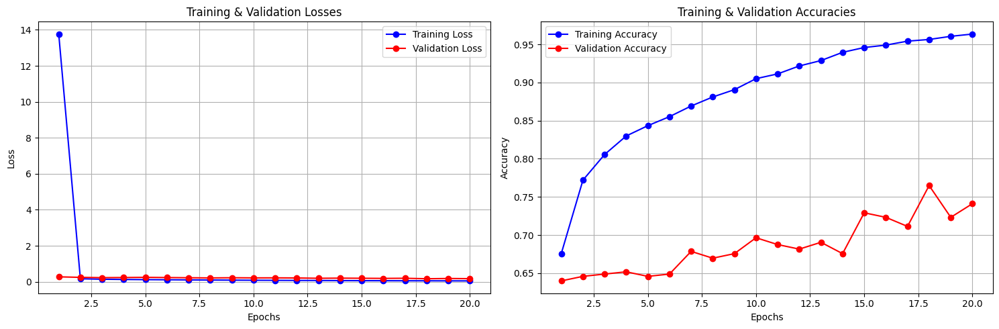

In [28]:
patience = [0,4]
weight_decay = [0.001, 0]
table = PrettyTable()
table.field_names = ["Patience (Early Stopping)", "Weight Decay", "Validation Accuracy (%)", "Test Accuracy (%)"]
for p, wd in zip(patience, weight_decay):
    hyperparameters['patience'] = p
    hyperparameters['weight_decay'] = wd
    
    # Train the model using the Siamese_main function
    _, avg_train_accuracy, avg_valid_accuracy, avg_test_accuracy, _ = Siamese_main(hyperparameters, plot_loss=True, disp_preds=False, print_tables=True, visualize=False)
    
    # Add the results to the table
    table.add_row([p, wd, f"{avg_valid_accuracy:.2f}", f"{avg_test_accuracy*100:.2f}"])

In [29]:
print(table)

+---------------------------+--------------+-------------------------+-------------------+
| Patience (Early Stopping) | Weight Decay | Validation Accuracy (%) | Test Accuracy (%) |
+---------------------------+--------------+-------------------------+-------------------+
|             0             |    0.001     |          67.11          |       63.39       |
|             4             |      0       |          68.65          |       74.40       |
+---------------------------+--------------+-------------------------+-------------------+


Clearly, `weight_decay` does not help but infact degraded the performance of the model. Hence, I will not use `weight_decay` for the rest of the ablation studies. This may be because the model is not actually able to overfit for 20 epochs. But using early stopping is mostly a better choice, as it saves time and resources. 
The `patience` of 4 or 5 was mostly working fine for me. 

### Changing LR Schedulers <a id="changing-lr-schedulers"></a>
> <font color="gray">Q7. Experiment with at least two learning rate schedulers and comment on what works, doesn’t
work, and potential reason why</font>

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 334.94002901121627 | Epoch Valid Loss: 430.4176839192708
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 265.20101156900097 | Epoch Valid Loss: 378.74224344889325
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 175.9115624316903 | Epoch Valid Loss: 245.49103546142578
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 108.65043963387956 | Epoch Valid Loss: 162.28975931803384
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 71.90229985325836 | Epoch Valid Loss: 112.18190002441406
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 52.796411991119385 | Epoch Valid Loss: 92.94932428995769
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 40.14192985102188 | Epoch Valid Loss: 81.16451009114583
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 31.64593000606049 | Epoch Valid Loss: 63.92097473144531
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 24.899036723513937 | Epoch Valid Loss: 56.32773399353027
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 19.75677014436833 | Epoch Valid Loss: 50.5670960744222
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 16.024784276651783 | Epoch Valid Loss: 46.265018463134766
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 12.863261711805366 | Epoch Valid Loss: 39.59484354654948
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 10.815922054440476 | Epoch Valid Loss: 36.66680018107096
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 8.608807189866553 | Epoch Valid Loss: 32.795507272084556
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 7.349979731752429 | Epoch Valid Loss: 28.243546962738037
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 6.09855017533829 | Epoch Valid Loss: 24.63852818806966
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 5.111109904598358 | Epoch Valid Loss: 20.96694294611613
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 4.437231888777988 | Epoch Valid Loss: 18.8198721408844
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 3.25488718616408 | Epoch Valid Loss: 14.434238513310751
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 2.6785936290181653 | Epoch Valid Loss: 12.392620921134949
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        50.91         |
|    Validation   |        50.39         |
|       Test      |        52.98         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.52      0.98      0.68       168
Positive Pair       0.81      0.08      0.14       168

     accuracy                           0.53       336
    macro avg       0.66      0.53      0.41       336
 weighted avg     

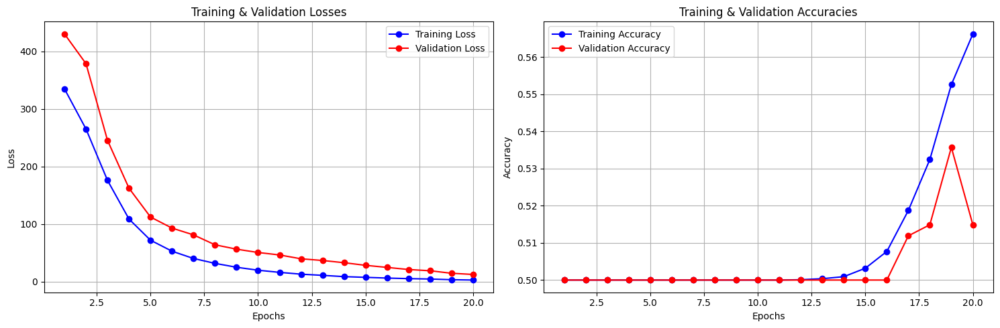

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 13.39366840668629 | Epoch Valid Loss: 0.40393320222695667
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.18579998157571914 | Epoch Valid Loss: 0.3244371861219406
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.1486705197671125 | Epoch Valid Loss: 0.29020577172438305
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.1292811997971216 | Epoch Valid Loss: 0.24505678315957388
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.11439461437010662 | Epoch Valid Loss: 0.2167691538731257
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.10351951128998121 | Epoch Valid Loss: 0.22437520821889242
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.09449075741780012 | Epoch Valid Loss: 0.21985175212224325
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.08599342629963229 | Epoch Valid Loss: 0.21012499431769052
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.07824871637641864 | Epoch Valid Loss: 0.20466684301694235
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.07080095120554053 | Epoch Valid Loss: 0.19765465209881464
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.06456224150349234 | Epoch Valid Loss: 0.18518426517645517
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.058513585981631346 | Epoch Valid Loss: 0.17320397744576135
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.054102567912534226 | Epoch Valid Loss: 0.18483397364616394
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.050705917157925835 | Epoch Valid Loss: 0.1764739528298378
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.048333267640690646 | Epoch Valid Loss: 0.1822332168618838
####################################################################################################


Epoch 00016: reducing learning rate of group 0 to 1.0000e-03.
####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.04689327424911912 | Epoch Valid Loss: 0.17442971716324487
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.03288302789469315 | Epoch Valid Loss: 0.17216464380423227
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.026239338041239874 | Epoch Valid Loss: 0.17437005043029785
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 0.023067019598255325 | Epoch Valid Loss: 0.17662159850200018
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 0.02160366420596188 | Epoch Valid Loss: 0.1756906807422638
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        90.53         |
|    Validation   |        69.20         |
|       Test      |        79.76         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.73      0.95      0.82       168
Positive Pair       0.93      0.64      0.76       168

     accuracy                           0.80       336
    macro avg       0.83      0.80      0.79       336
 weighted avg    

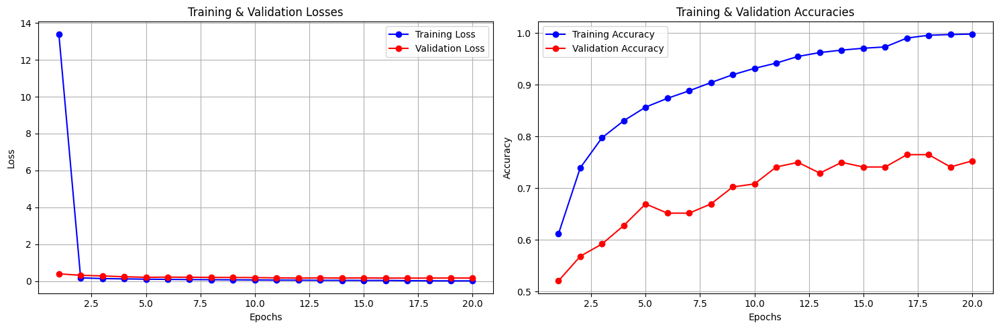

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 12.04593789368478 | Epoch Valid Loss: 0.22127984712521234
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.13943861696739182 | Epoch Valid Loss: 0.20488413671652475
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.11351242590002543 | Epoch Valid Loss: 0.1901798223455747
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.1027500377264047 | Epoch Valid Loss: 0.1779708390434583
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.09329616512323535 | Epoch Valid Loss: 0.16232054432233176
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.0839055287272691 | Epoch Valid Loss: 0.14898857225974402
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.07667711165430414 | Epoch Valid Loss: 0.142839252948761
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.06933119819434576 | Epoch Valid Loss: 0.14575911685824394
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.06260731270493464 | Epoch Valid Loss: 0.15275909006595612
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.056560563963166506 | Epoch Valid Loss: 0.1421316626171271
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.05095937539996623 | Epoch Valid Loss: 0.14177158723274866
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.045417309608743635 | Epoch Valid Loss: 0.14463435982664427
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.040887696557505016 | Epoch Valid Loss: 0.1433181402583917
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.036224204150764924 | Epoch Valid Loss: 0.13698652759194374
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.03134924993947755 | Epoch Valid Loss: 0.14094617466131845
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.027309895801726124 | Epoch Valid Loss: 0.14811041951179504
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 0.023947560141772725 | Epoch Valid Loss: 0.1440365637342135
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 0.020292076596253834 | Epoch Valid Loss: 0.14824974661072096
####################################################################################################


Early stopping!!, Since validation loss has not improved in the last 5 epochs.
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        93.24         |
|    Validation   |        77.11         |
|       Test      |        77.38         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.71      0.92      0.80       168
Positive Pair       0.89      0.62      0.73       168

     accuracy                           0.77       336
    macro avg       0.80      0.77      0.77       336
 weighted avg       0.80      0.77      0.77       336



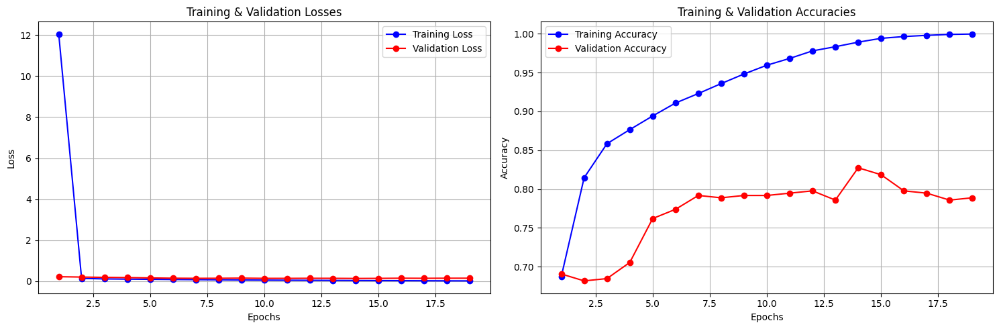

In [25]:
lr_scheduler = ['CyclicLR', 'ReduceLROnPlateau', 'CosineAnnealingLR']
table = PrettyTable()
table.field_names = ["Learning Rate Scheduler", "Validation Accuracy (%)", "Test Accuracy (%)"]
for lr_s in lr_scheduler:
    hyperparameters['lr_scheduler'] = lr_s  
    
    # Train the model using the Siamese_main function
    _, avg_train_accuracy, avg_valid_accuracy, avg_test_accuracy, _ = Siamese_main(hyperparameters, plot_loss=True, disp_preds=False, print_tables=True, visualize=False)
    
    # Add the results to the table
    table.add_row([lr_s, f"{avg_valid_accuracy:.2f}", f"{avg_test_accuracy*100:.2f}"])

In [26]:
print(table)

+-------------------------+-------------------------+-------------------+
| Learning Rate Scheduler | Validation Accuracy (%) | Test Accuracy (%) |
+-------------------------+-------------------------+-------------------+
|         CyclicLR        |          50.39          |       52.98       |
|    ReduceLROnPlateau    |          69.20          |       79.76       |
|    CosineAnnealingLR    |          77.11          |       77.38       |
+-------------------------+-------------------------+-------------------+


`CyclicLR` was not helping and infact I got reduced values of validation and test accuracy. This may be because changing the learning rate too frequently is not a good idea. 

Using `ReduceLROnPlateau` with `patience=4` was working fine for me as everytime the validation loss did not decrease for 4 epochs, the learning rate was reduced by a factor of 0.1. It particularly helped me a lot when I trained the model for more (~100) epochs for some other experiments. Hence, I will fix `ReduceLROnPlateau` with `patience=4` for the rest of the ablation studies.

Sometimes, my validation accuracy was lower than test accuracy which may be due to some hard pairs in the validation set. Using `CosineAnnealingLR` helped me increasing the validation accracy mainly but test accuracy was more or less same. 


### Changing Optimizers <a id="changing-optimizers"></a>
> <font color="gray">Q8. Experiment with at least two different optimizers and comment on what works, doesn’t work,
and potential reason why</font>

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 10.19689772530394 | Epoch Valid Loss: 0.18926547964413962
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.145107333905735 | Epoch Valid Loss: 0.1839388683438301
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.11170682590996284 | Epoch Valid Loss: 0.17346367239952087
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.10023720446584183 | Epoch Valid Loss: 0.16485531131426492
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.09100647998410602 | Epoch Valid Loss: 0.1554315264026324
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.08387462541915823 | Epoch Valid Loss: 0.1557042971253395
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.0773201089211588 | Epoch Valid Loss: 0.14777317643165588
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.07071908920743437 | Epoch Valid Loss: 0.14722862218817076
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.06486375623945753 | Epoch Valid Loss: 0.1538392243285974
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.05868110012772038 | Epoch Valid Loss: 0.14388633891940117
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.05284583216078233 | Epoch Valid Loss: 0.14834696426987648
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 0.047101779407713304 | Epoch Valid Loss: 0.14359673112630844
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 0.041900475523001406 | Epoch Valid Loss: 0.1542908251285553
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 0.038480532547827205 | Epoch Valid Loss: 0.1523377113044262
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 0.03327501636285465 | Epoch Valid Loss: 0.1462870861093203
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 0.028896795863253173 | Epoch Valid Loss: 0.1516448656717936
####################################################################################################


Early stopping!!, Since validation loss has not improved in the last 5 epochs.
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        92.08         |
|    Validation   |        77.66         |
|       Test      |        78.57         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.73      0.92      0.81       168
Positive Pair       0.89      0.65      0.75       168

     accuracy                           0.79       336
    macro avg       0.81      0.79      0.78       336
 weighted avg       0.81      0.79      0.78       336



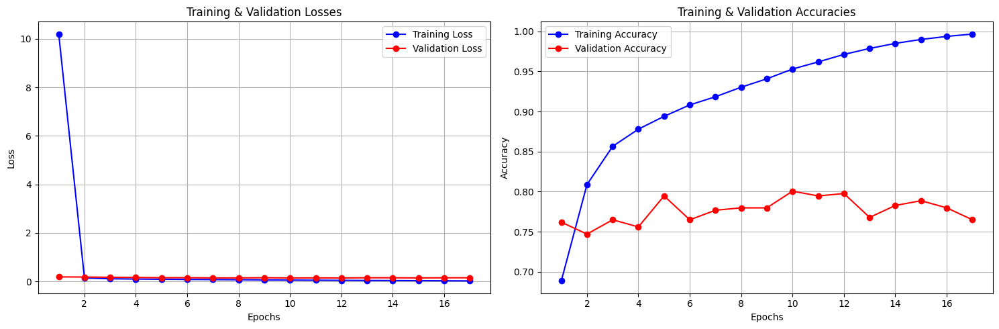

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 40.546296094046085 | Epoch Valid Loss: 33.5869509379069
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 12.409299084960027 | Epoch Valid Loss: 26.213935057322185
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 7.704364567128724 | Epoch Valid Loss: 21.799962838490803
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 5.538284556463707 | Epoch Valid Loss: 17.739881197611492
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 4.397340061532897 | Epoch Valid Loss: 18.139649987220764
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 3.7680877026950204 | Epoch Valid Loss: 14.46757205327352
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 3.310003502251104 | Epoch Valid Loss: 14.895620862642923
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 2.873960271824238 | Epoch Valid Loss: 13.636064012845358
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 2.7160690668537173 | Epoch Valid Loss: 12.564735015233358
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 2.457050911692339 | Epoch Valid Loss: 13.022805750370026
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 2.475944201786851 | Epoch Valid Loss: 11.63562786579132
####################################################################################################


####################################################################################################
Epoch: [12/20] | Epoch Train Loss: 2.4156771529639185 | Epoch Valid Loss: 12.757775863011679
####################################################################################################


####################################################################################################
Epoch: [13/20] | Epoch Train Loss: 2.1634086669790884 | Epoch Valid Loss: 12.095589955647787
####################################################################################################


####################################################################################################
Epoch: [14/20] | Epoch Train Loss: 2.0483182883539865 | Epoch Valid Loss: 12.931809107462565
####################################################################################################


####################################################################################################
Epoch: [15/20] | Epoch Train Loss: 1.9742380696846995 | Epoch Valid Loss: 11.300092538197836
####################################################################################################


####################################################################################################
Epoch: [16/20] | Epoch Train Loss: 1.9438011450476425 | Epoch Valid Loss: 12.350597361723581
####################################################################################################


####################################################################################################
Epoch: [17/20] | Epoch Train Loss: 1.889553073447111 | Epoch Valid Loss: 11.069313526153564
####################################################################################################


####################################################################################################
Epoch: [18/20] | Epoch Train Loss: 1.8612168593938614 | Epoch Valid Loss: 11.239209512869516
####################################################################################################


####################################################################################################
Epoch: [19/20] | Epoch Train Loss: 1.9430880311573313 | Epoch Valid Loss: 11.669143279393515
####################################################################################################


####################################################################################################
Epoch: [20/20] | Epoch Train Loss: 1.9293758157034253 | Epoch Valid Loss: 11.333933671315512
####################################################################################################
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        57.35         |
|    Validation   |        54.45         |
|       Test      |        55.36         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.53      0.95      0.68       168
Positive Pair       0.75      0.16      0.26       168

     accuracy                           0.55       336
    macro avg       0.64      0.55      0.47       336
 weighted avg     

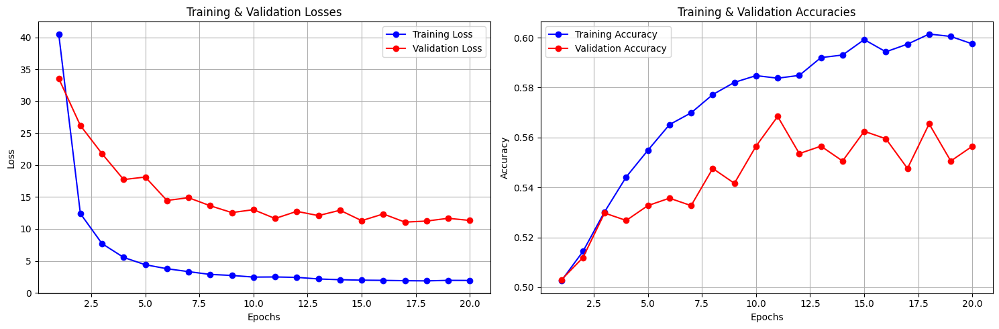

Generating augmented images...
Total number of augmented images generated = Augmented Persons x Augmentations per person = 4069 x 4 = 16276
Generating tensors...
Toal number of persons: 5749
Number of persons with more than one image: 1680
+----------------+-------------------+--------------------------+--------------------------+
| Dataset Split  | Number of Persons | Number of Positive Pairs | Number of Negative Pairs |
+----------------+-------------------+--------------------------+--------------------------+
|  Training Set  |        5413       |          22011           |          22011           |
| Validation Set |        168        |           168            |           168            |
|    Test Set    |        168        |           168            |           168            |
+----------------+-------------------+--------------------------+--------------------------+
Training Siamese Network with Hyperparameters:
{'batch_size': 64, 'random_seed': 42, 'epochs': 20, 'learning_

####################################################################################################
Epoch: [1/20] | Epoch Train Loss: 6.317873699352319 | Epoch Valid Loss: 0.27770861983299255
####################################################################################################


####################################################################################################
Epoch: [2/20] | Epoch Train Loss: 0.15955741654778288 | Epoch Valid Loss: 0.26021069039901096
####################################################################################################


####################################################################################################
Epoch: [3/20] | Epoch Train Loss: 0.10808601762103133 | Epoch Valid Loss: 0.15847324828306833
####################################################################################################


####################################################################################################
Epoch: [4/20] | Epoch Train Loss: 0.08433544679631501 | Epoch Valid Loss: 0.16816247006257376
####################################################################################################


####################################################################################################
Epoch: [5/20] | Epoch Train Loss: 0.0705690256774772 | Epoch Valid Loss: 0.14856064692139626
####################################################################################################


####################################################################################################
Epoch: [6/20] | Epoch Train Loss: 0.05990622887864362 | Epoch Valid Loss: 0.14153078322609267
####################################################################################################


####################################################################################################
Epoch: [7/20] | Epoch Train Loss: 0.05049447365224275 | Epoch Valid Loss: 0.12924509247144064
####################################################################################################


####################################################################################################
Epoch: [8/20] | Epoch Train Loss: 0.042431214312632935 | Epoch Valid Loss: 0.16578919192155203
####################################################################################################


####################################################################################################
Epoch: [9/20] | Epoch Train Loss: 0.036165059733659376 | Epoch Valid Loss: 0.14358108987410864
####################################################################################################


####################################################################################################
Epoch: [10/20] | Epoch Train Loss: 0.031050726516865367 | Epoch Valid Loss: 0.15590985864400864
####################################################################################################


####################################################################################################
Epoch: [11/20] | Epoch Train Loss: 0.026650781881302422 | Epoch Valid Loss: 0.14584597200155258
####################################################################################################


Early stopping!!, Since validation loss has not improved in the last 5 epochs.
+----------------------------------------+
| Model Performance with 'resnet18' base |
+-----------------+----------------------+
|      Split      |     Accuracy (%)     |
+-----------------+----------------------+
|     Training    |        91.13         |
|    Validation   |        76.12         |
|       Test      |        81.85         |
+-----------------+----------------------+
Classification Report:
               precision    recall  f1-score   support

Negative Pair       0.78      0.89      0.83       168
Positive Pair       0.87      0.74      0.80       168

     accuracy                           0.82       336
    macro avg       0.83      0.82      0.82       336
 weighted avg       0.83      0.82      0.82       336



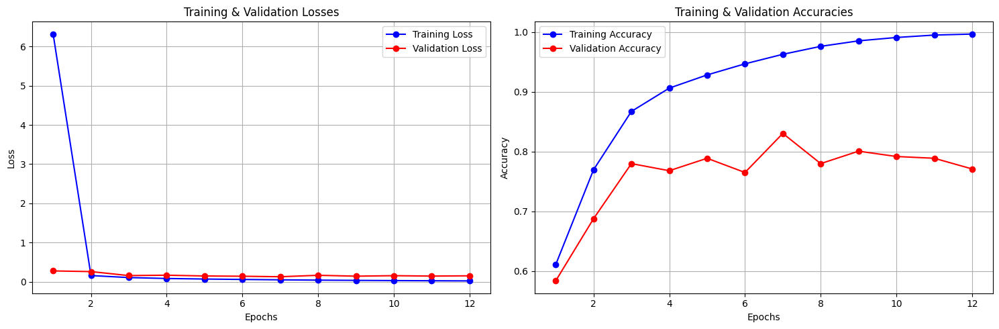

In [27]:
optimisers = ['Adam', 'Adagrad', 'RMSprop']
table = PrettyTable()
table.field_names = ["Learning Rate Scheduler", "Validation Accuracy (%)", "Test Accuracy (%)"]
for optimiser in optimisers:
    hyperparameters['optimizer_type'] = optimiser
    
    # Train the model using the Siamese_main function
    _, avg_train_accuracy, avg_valid_accuracy, avg_test_accuracy, _ = Siamese_main(hyperparameters, plot_loss=True, disp_preds=False, print_tables=True, visualize=False)
    
    # Add the results to the table
    table.add_row([optimiser, f"{avg_valid_accuracy:.2f}", f"{avg_test_accuracy*100:.2f}"])

In [28]:
print(table)

+-------------------------+-------------------------+-------------------+
| Learning Rate Scheduler | Validation Accuracy (%) | Test Accuracy (%) |
+-------------------------+-------------------------+-------------------+
|           Adam          |          77.66          |       78.57       |
|         Adagrad         |          54.45          |       55.36       |
|         RMSprop         |          76.12          |       81.85       |
+-------------------------+-------------------------+-------------------+


`Adam` is undoubtedly the best optimizer for this task. `Adagrad` and `RMSProp` are not able to converge properly as it can be seen from the loss curves. Hence, I fixed `Adam` as the default optimizer. 

Using the above tuned hyperparameters, I trained the model and I got some best models for Siamese Network (stored in best_models folder) which we can use for testing on real images.

### Testing on Real Images <a id="testing-on-real-images"></a>
> <font color="gray">Q10. Gather a few images of yourself and your friends (with their consent) and check if the model
works well on this data</font>

In [23]:
data_dir = pl.Path('./real_images/')
persons_dirs = [d for d in data_dir.iterdir() if d.is_dir()] # List all subdirectories (each directory corresponds to a person)
real_persons_dict = {person_dir.name: len(list(person_dir.glob("*.jpg"))) for person_dir in persons_dirs} # Create a dictionary of all persons and the number of images they have
all_persons = list(real_persons_dict.keys())                  # List of all persons

In [24]:
print(f"Toal number of persons: {len(all_persons)}")
for person, num_images in real_persons_dict.items():
    print(f"{person}: {num_images} images")

Toal number of persons: 4
AT: 10 images
RG: 12 images
AY: 10 images
MM: 9 images


In [25]:
def generate_pairs(persons_dict, max_positive_combinations, apply_augmentation, num_augmentations):
    """
    Generates pairs of images (both positive and negative) for Siamese training.
    
    Args:
    - persons_dict (dict): Dictionary with person names as keys and the number of images as values.
    - max_positive_combinations (int): Maximum number of positive combinations per person.
    Returns:
    - X (list): List of image pairs.
    - Y (list): List of labels indicating whether the pair is positive or negative.
    - positive_pairs_count (int): Number of positive pairs.
    - negative_pairs_count (int): Number of negative pairs.
    """
    X, Y = [], []                                               # Initialize lists for image pairs and labels
    person_names = list(persons_dict.keys())                    # List of person names
    
    real_imgs_dir = pl.Path('./real_images/')                   # Setting path to the real images directory
    positive_pairs_count, negative_pairs_count = 0, 0           # Initialize counters for positive and negative pairs
            
    for idx, person in enumerate(person_names):                 # Loop through all persons
        person_dir = real_imgs_dir / person                          # Path to the person's directory
        images = list(person_dir.glob("*.jpg"))                 # List all images in the person's directory
            
        # Positive pairs generation from original images
        if len(images) >= 2:                                    # Only generate pairs if the person has more than one image
            all_combinations = list(combinations(images, 2))    # Generate all possible combinations of images
            selected_combinations = random.sample(all_combinations, min(max_positive_combinations, len(all_combinations)))  # Select a random subset of combinations constrained by max_positive_combinations
            
            for img1, img2 in selected_combinations:        # Loop through all selected combinations
                X.append([img1, img2])                      # Append the pair to the list of pairs
                Y.append(1.0)                               # Same person
                positive_pairs_count += 1                   # Increment the counter for positive pairs

                # Generate a negative pair for every positive pair  
                other_persons = [p for p in person_names if p != person]    # List of all other persons
                if other_persons:                                           # Only generate negative pairs if there are other persons
                    other_person = random.choice(other_persons)             # Select a random other person
                    other_person_dir = real_imgs_dir / other_person              # Path to the other person's directory
                    other_person_images = list(other_person_dir.glob("*.jpg"))  # List all images in the other person's directory
                    
                    if other_person_images:                                 # Only generate negative pairs if the other person has images
                        img1_neg = random.choice(images)                    # Select a random image from the original person
                        img2_neg = random.choice(other_person_images)       # Select a random image from the other person
                        X.append([img1_neg, img2_neg])                      # Append the pair to the list of pairs
                        Y.append(0.0)                                       # Different persons
                        negative_pairs_count += 1                           # Increment the counter for negative pairs
                        
    return X, Y, positive_pairs_count, negative_pairs_count

Number of positive pairs: 40
Number of negative pairs: 40


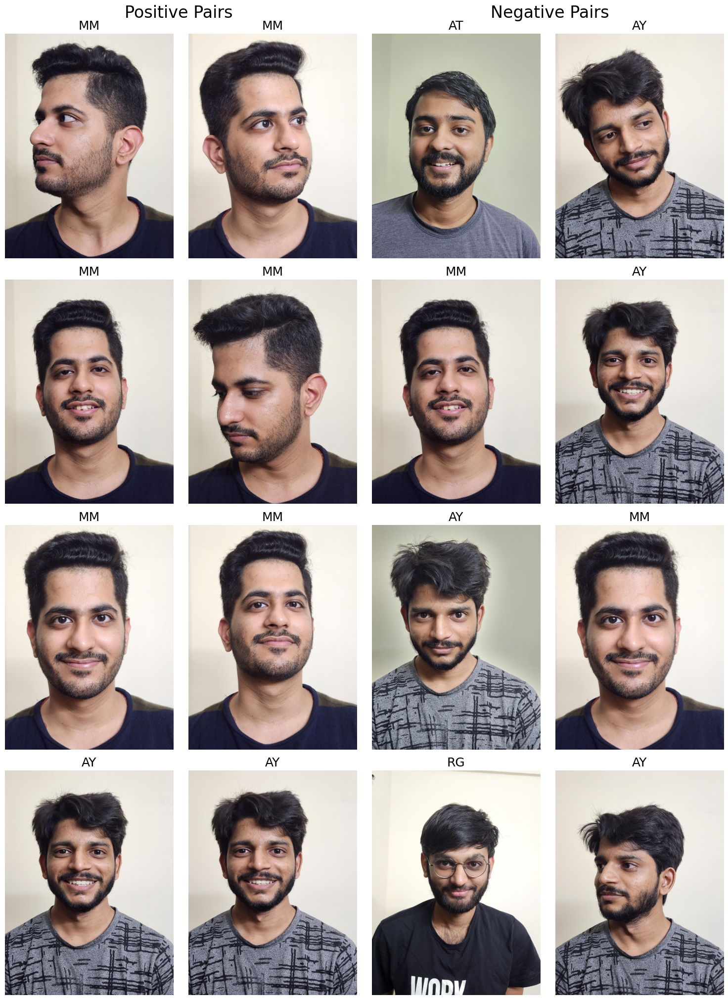

In [26]:
X_real_pairs, Y_real_pairs, positive_pairs_count_real, negative_pairs_count_real = generate_pairs(real_persons_dict, max_positive_combinations=10, apply_augmentation=False, num_augmentations=0)
print(f"Number of positive pairs: {positive_pairs_count_real}")
print(f"Number of negative pairs: {negative_pairs_count_real}")
visualize_pairs(X_real_pairs, Y_real_pairs)

In [27]:
def preprocess_data(X):
    """
    Preprocess the images in X using albumentations by applying a center crop and normalization.

    Args:
    - X (list): List of image pairs.

    Returns:
    - X_processed (list): List of preprocessed image pairs.
    """
    transform = A.Compose([
        A.Resize(512, 512),
        # A.CenterCrop(256, 256),    
        A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ToTensorV2()
    ])
    
    X_processed = []

    for pair in X:
        processed_pair = [transform(image=np.array(Image.open(img_path)))["image"] for img_path in pair]
        X_processed.append(processed_pair)

    return X_processed

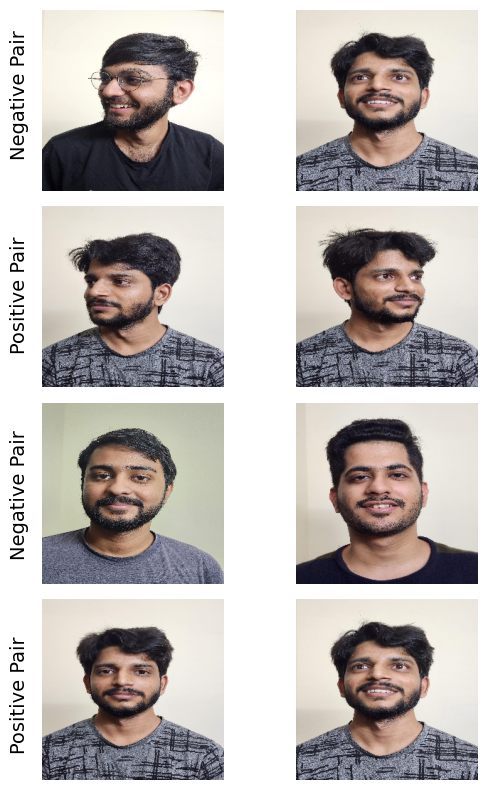

In [44]:
X_real, Y_real = dict_to_tensors(real_persons_dict, max_positive_combinations=10, apply_augmentation=False, num_augmentations=0)
real_dataset = SiameseDataset(X_real, Y_real)
real_loader = DataLoader(real_dataset, batch_size=64, shuffle=False, num_workers=16, pin_memory=True)
visualize_batch(real_loader)

In [42]:
trained_model_siamese = SiameseNetwork(base_model='resnet18', unfreeze_last_n=4).to(device)
trained_model_siamese_weights_path = './best_models/Best_Model_val_acc_78.30_test_acc_83.63.pth'
trained_model_siamese.load_state_dict(torch.load(trained_model_siamese_weights_path, map_location=device))
trained_model_siamese.eval()  # Set the model to evaluation mode

# Evaluate the model on real_loader
test_accuracy_real, class_report_real = evaluate_model(trained_model_siamese, real_loader, threshold=0.2, loss_function='contrastive')

# Print results
print(f"Test Accuracy on Real Images: {test_accuracy_real*100:.2f}%")
print("Classification Report:\n", class_report_real)

Test Accuracy on Real Images: 70.00%
Classification Report:
                precision    recall  f1-score   support

Negative Pair       0.83      0.50      0.62        40
Positive Pair       0.64      0.90      0.75        40

     accuracy                           0.70        80
    macro avg       0.74      0.70      0.69        80
 weighted avg       0.74      0.70      0.69        80



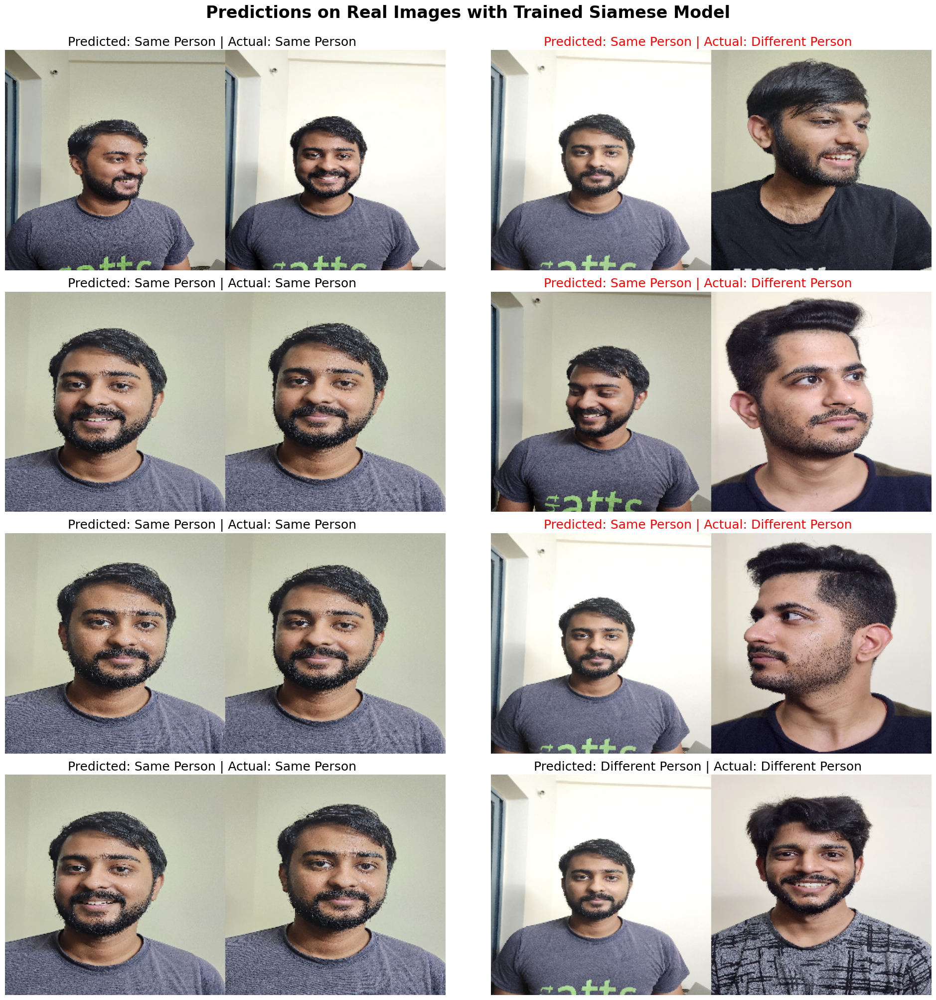

In [41]:
display_predictions(trained_model_siamese, real_loader, threshold=0.2, title=f"Predictions on Real Images with Trained Siamese Model", loss_function='contrastive')

### References:   <a id="references"></a>
1.  https://github.com/Mitix-EPI/Face-Recognition-using-Siamese-Networks/tree/main
2.  https://github.com/pytorch/examples/tree/main/siamese_network
3.  https://pytorch.org/vision/0.15/models.html
4.  https://chat.openai.com
5.  https://www.youtube.com/watch?v=9hLcBgnY7cs&t=490s
6.  https://pytorch.org/docs/stable/generated/torch.nn.MarginRankingLoss.html
7.  https://pytorch.org/docs/stable/optim.html
8.  https://www.youtube.com/watch?v=pG0QZ7OddX4
9.  https://discuss.pytorch.org/t/discussion-why-normalise-according-to-imagenet-mean-and-std-dev-for-transfer-learning/115670